# Computer Vision - P4


·**Template matching**: Using SSD and normalized cross-correlation.

·**Histogram od Oriented Gradients (HOG)**: To object detection. Pedestrian recoggnition.

·**CENSURE algorithm to detect interestig points**

·**ORB**--> Used for feature detection (interesting points) and describing its environment (matching different angle images). Different images and orientations.

·**SIFT**

## Delivery

Your overall grading will be penalized if the following requirements are not fulfilled:

- Implemented code should be commented exhaustively and in *English*.

- The questions introduced in the exercises must be answered.

- Add title to the figures to explain what is displayed.

- Answers to questions also need to be in *English*.

- Make sure to print and plot exactly what it is indicated. If a reference image is provided, your output is expected to be exactly the same unless instructed differently.

- The deliverable of both parts must be a file named **P4_Student1_Student2.zip** that includes:
    - The notebook P4_Student1_Student2.ipynb completed with the solutions to the exercises and their corresponding comments.
    - All the images used in this notebook (upload the ones that were not provided)
    
- It is required that your code can be run by us without need of any modification and without getting any errors.

- Use packages and solutions that were covered in your class and tutorials. If you are unsure about using a particular package, you should seek clarification from your instructor to confirm whether it is allowed.

- Please refrain from utilizing resources like ChatGPT to complete this lab assignment.


**Deadline (Campus Virtual): November 28th, 23:00 h**

==============================================================================================
## Descriptors extraction for object detection, based on template matching, ORB, and HOG
==============================================================================================

The main topics of Laboratory 4 are:

    4.1) SSD and Normalized Cross-correlation for template matching

    4.2) HOG image descriptor for object (person) detection

    4.3) Recognition by correspondance, based on feature extraction (ORB)

In [209]:
# Libraries
from skimage import io
import numpy as np    
import matplotlib.pyplot as plt
%matplotlib inline                     

# Function to encapsulate the visualization of n images in a row (1xn figure)
def show_images(images, titles):
    fig = plt.figure(figsize=(20,30))
    for i,(im,t) in enumerate(zip(images,titles)):
        fig.add_subplot(5, 5, i+1)
        plt.title(t)
        plt.imshow(im, cmap='gray')
        plt.axis("off")
    plt.show()

In order to complete this practicum, the following concepts need to be understood: template matching, feature localization (Harris, Censure), feature descriptor (HOG,ORB, Sift) methods.

It is highly recommendable to structure the code in functions in order to reuse code for different tests and images and make it shorter and more readable. Specially the visualization commands should be encapsulated in separate functions.

## 1 Template matching

**1.1 (10 points)** Given the image 'einstein.png' and the template image 'eye.png', detect the location of the template in the image comparing the use of:
- SSD distance (hint: norm() in numpy.linalg).
- normalized cross-correlation (hint: match_template() of skimage.feature).

Don't forget to normalize the images (having pixel values between [0,1]) before comparing them.

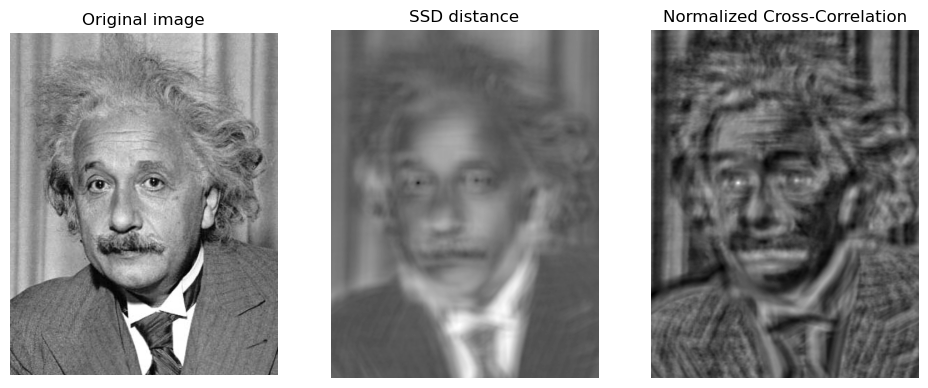

SSD min: 1.9895304595412766
NCC max: 0.9768202443115026
SSD max: 24.80233646024032
NCC min: -0.5212545112767212


In [210]:
from skimage.util import img_as_float
from skimage.feature import match_template     # Normalized X-Correlation
from skimage.exposure import rescale_intensity # [0,1] normalization

einstein = io.imread("images/einstein.png")
eye = io.imread("images/eye.png")

def SSD(image, template):
    max_x, max_y = image.shape
    x, y = template.shape
    result = np.zeros((max_x-x+1,max_y-y+1))
    for m in range(max_x - x + 1):
        for n in range(max_y - y + 1):
            norm = np.linalg.norm(template - image[m:m+x, n:n+y])
            #In this case, we want the matches of template in black color
            result[m, n] = norm
    return result


# Encapsulation of both techniques
# Match template is a function of skimage.feature that gives the output for the normalized cross-correlation
# We provide two gray images as inputs
def template_matching(img, template):
    return SSD(img, template), match_template(img, template)

# Encapsulation to construct and show images
def compare_SSD_NCC(img, template):
    ssd,ncc = template_matching(img,template)
    
    show_images([img,rescale_intensity(ssd, out_range=(0, 1)),rescale_intensity(ncc, out_range=(0, 1))],['Original image', 'SSD distance', 'Normalized Cross-Correlation'])
    return ssd,ncc

# Load images, as gray in order to have a single channel
einstein = io.imread('images/einstein.png', as_gray=True)
eye = io.imread('images/eye.png', as_gray=True)

# Compare SSD & NCC
ssd,ncc = compare_SSD_NCC(einstein,eye)
print(f"SSD min: {ssd.min()}\nNCC max: {ncc.max()}")
print(f"SSD max: {ssd.max()}\nNCC min: {ncc.min()}")


Create a **function** for template matching applying SSD distance and normalized cross-correlation and display the results in the following format:

<img src="images/tm.png" width="800" height="400">

**Use titles in all figures to understand what is being displayed.**

Note: the decision of threshold for SSD distance and normalized cross-correlation will affect your results, try values that get you as close to the shown result as possible but we understand you might not get exactly the same outcome.

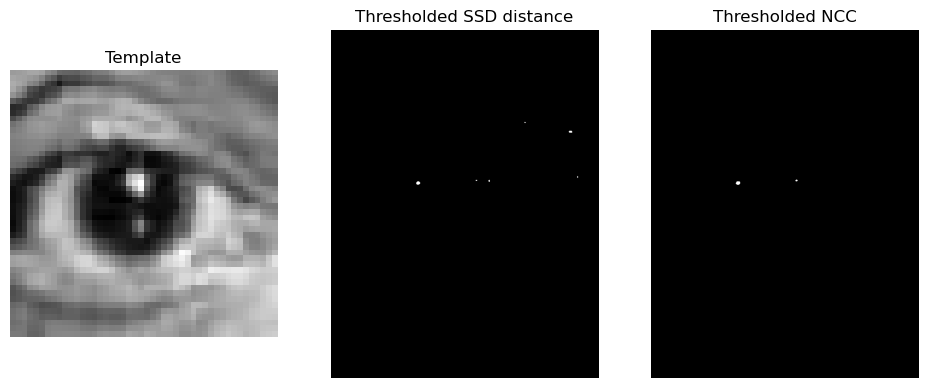

In [123]:
# Encapsulation to construct and show thresholded images
def get_matches(template, ssd, ncc, ssd_threshold=8.59, ncc_threshold=0.52):
    # High similarity: low SSD distance and high NCC
    binary_ssd = ssd < ssd_threshold
    binary_ncc = ncc > ncc_threshold
    show_images([template,binary_ssd,binary_ncc],['Template','Thresholded SSD distance','Thresholded NCC'])
    
# Get thresholded images
get_matches(eye, ssd, ncc)


**1.2 (5 points)** How does the result of the template matching change if the image changes its contrast (for example if you make it clearer or darker)?

Similarly to the previous case, please, visualize the euclidean distance and normalized cross-correlation images as well as the binarized (thresholded) images in the two cases.

**Note:** Use titles of the figures to explain what is displayed.


Read `einstein_br.png` and display the results of the template matching techniques used on 1.1 on this image, using `eye.png` as template:

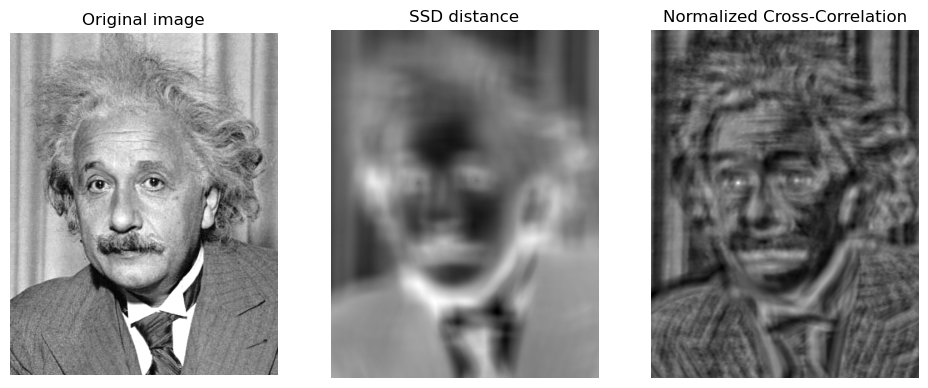

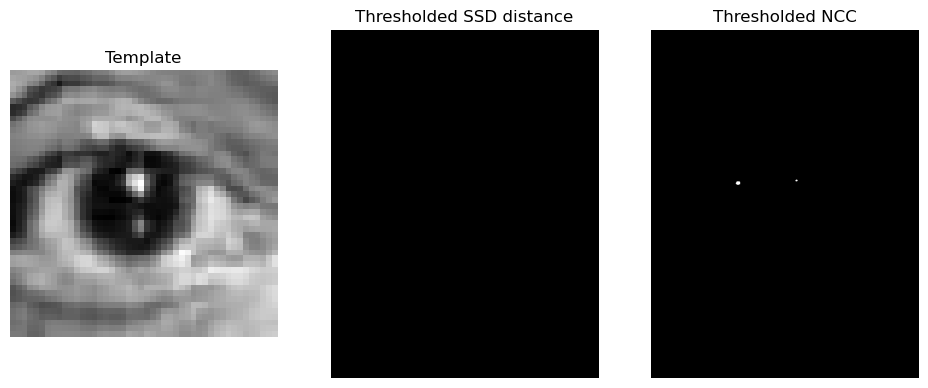

In [130]:
einstein_br = img_as_float(io.imread("images/einstein_br.png"))#in this case this image is gray already
# Compare SSD & NCC
ssd,ncc = compare_SSD_NCC(einstein_br,eye)

# Get thresholded images
get_matches(eye,ssd,ncc)

Print the minimum SSD and the maximum Normalized Cross-Correlation (NCC)

In [132]:
print(f"SSD min: {ssd.min()}\nNCC max: {ncc.max()}")


SSD min: 23.700079380083967
NCC max: 0.9768232838639458


**1.3 (5 points)** Read `einstein_mask.png` and display the results on this image using your previously coded function, using the `eye.png` template:

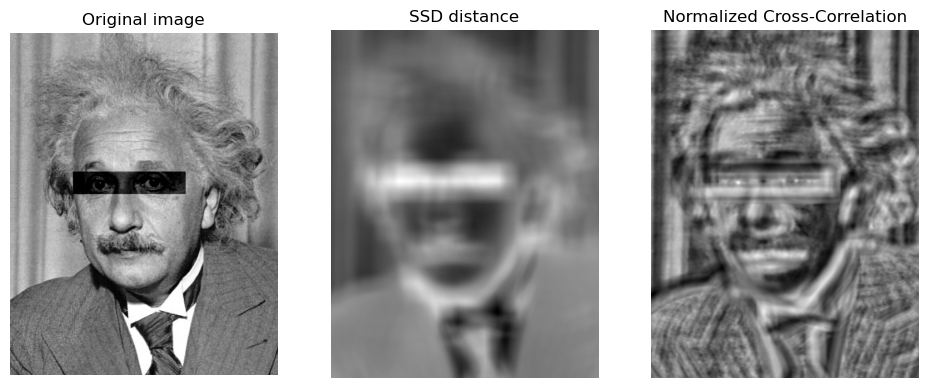

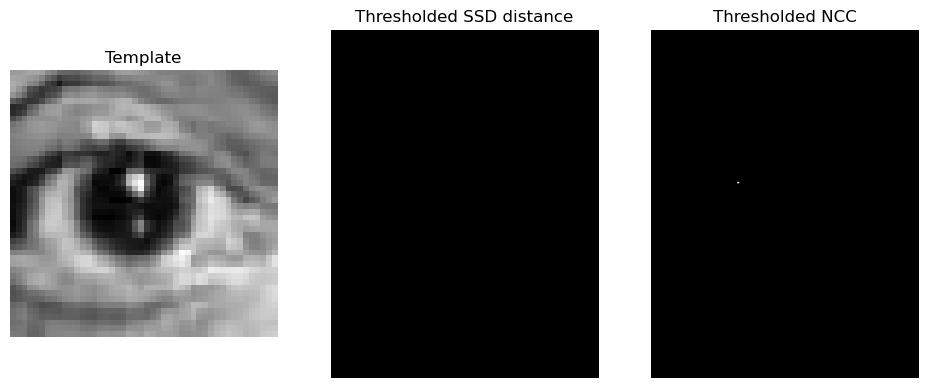

In [126]:
einstein_mask = img_as_float(io.imread("images/einstein_mask.png"))

# Compare SSD & NCC
ssd,ncc = compare_SSD_NCC(einstein_mask,eye)

# Get thresholded images
get_matches(eye,ssd,ncc)


Print the minimum SSD and the maximum NCC

In [134]:
print(f"SSD min: {ssd.min()}\nNCC max: {ncc.max()}")


SSD min: 23.700079380083967
NCC max: 0.9768232838639458


What are the distances between the template and the image around the eyes of the image?

Bigger than 8.59 in the ssd, since we see no response in the thresholded image. We see that with ncc we keep having the white left eye, so we can see the distances:

In [128]:
ncc[ncc>0.52]

array([0.56832164, 0.60608706, 0.59949664, 0.55842235, 0.56449538,
       0.61663627, 0.61574153, 0.57064166, 0.53558841, 0.59066845,
       0.59332843, 0.54986508])

Comment the template matching process:
* Is the algorithms affected by contrast changes in the image?
* How do metrics (i.e. minimum euclidean distance and maximum NCC) change in all previous cases? Is there a big difference among these values?
* What parameters it has and which measure for image comparisons works better.

**Answer 1**: We have seen SSD distance is very sensitive to contrast change. These changes also affect NCC (note that in the last images we only got one eye match) but it behaves better compared to SSD.
**Answer 2**: SSD experience a significative change in its values when applying the einstein_br. In this case all distances are higher than 8.69, so that's why we don't see anything in the thresholded image. Contrary, the maximum value of ncc dowsn't change a lot. That's why we keep seeing the point of the left eye.
**Answer 3**: The parameters are the values of the thresholds used to obtain the binary images (the coincidences with the template). We have seen NCC is a better measure for template matching.

**1.4 (5 points)** How does the result of the template matching change if instead the template is the one that changes its contrast (for example if you make it clearer or darker)? To this purpose, use the `eye_br.png` template.

**Answer**: We get only a match with NCC, is the only one that really is sensitive to a change of the contrast.

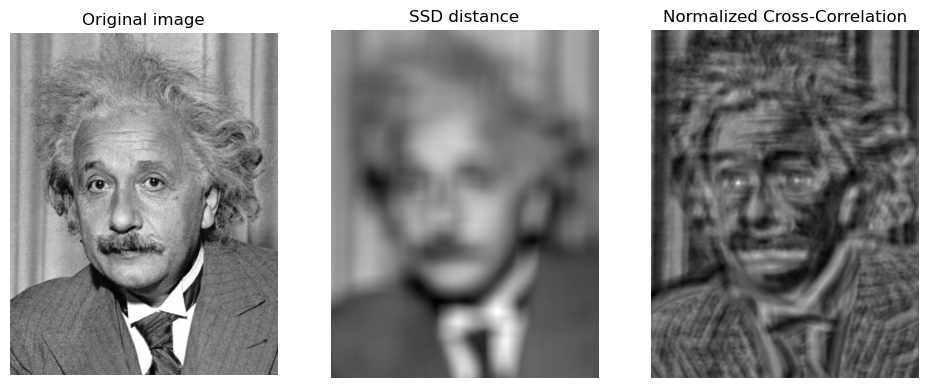

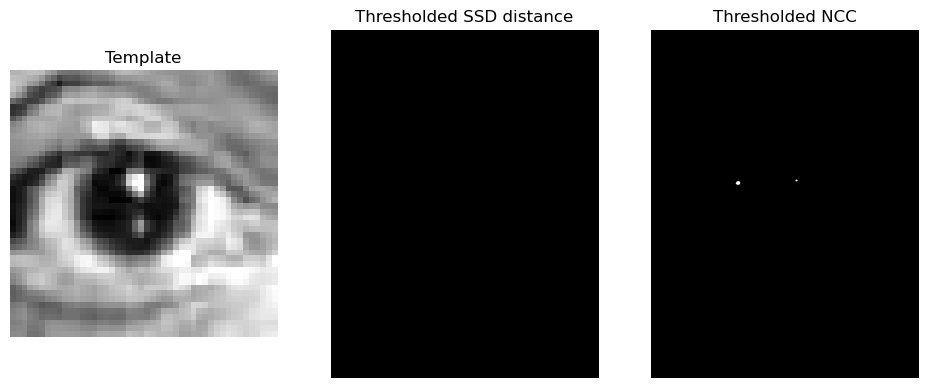

In [141]:
eye_br = img_as_float(io.imread("images/eye_br.png"))

# Compare SSD & NCC
ssd,ncc = compare_SSD_NCC(einstein,eye_br)

# Get thresholded images
get_matches(eye_br,ssd,ncc)

Check how the result changes if the template is rotated.

Visualize the template and its rotation by 2º, 5º, 10º, 15º and 20º. Obtain again the template matching using the Euclidean distance and normalized cross-correlation. Pick fixed values of thresholds that are well suited for the non rotated image.  

**Help:** use the function rotate() in skimage.transform

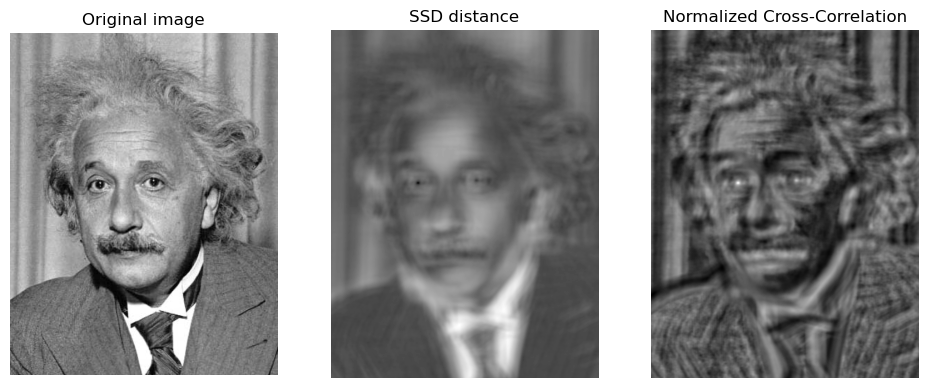

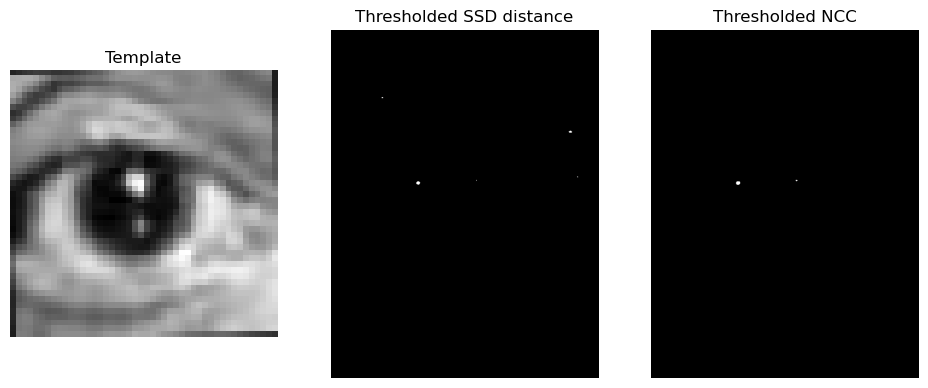

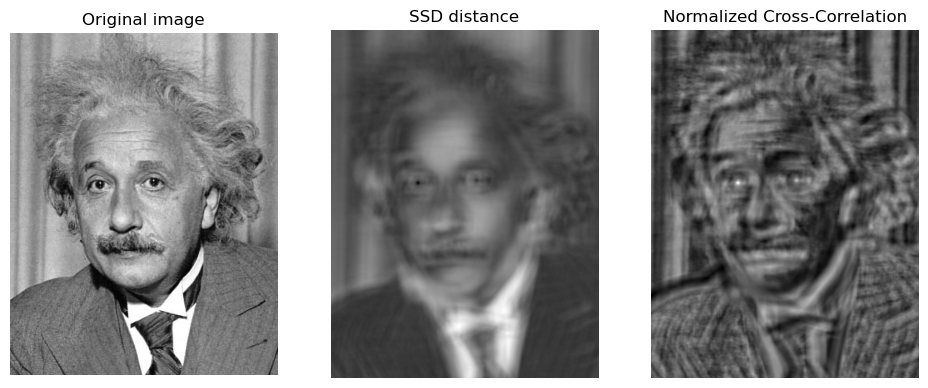

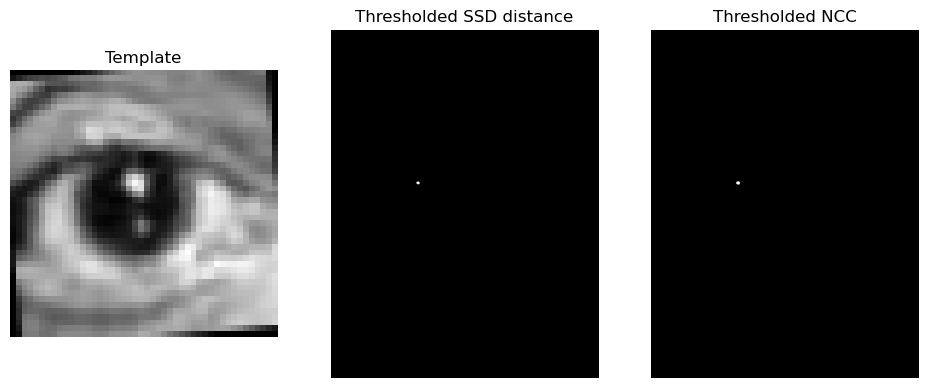

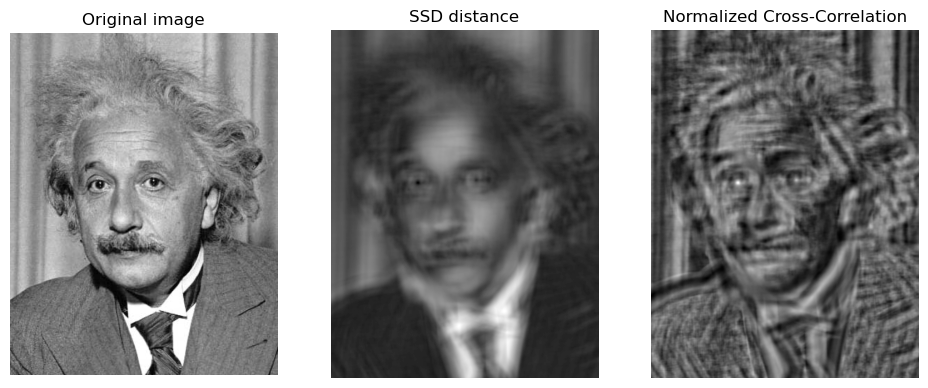

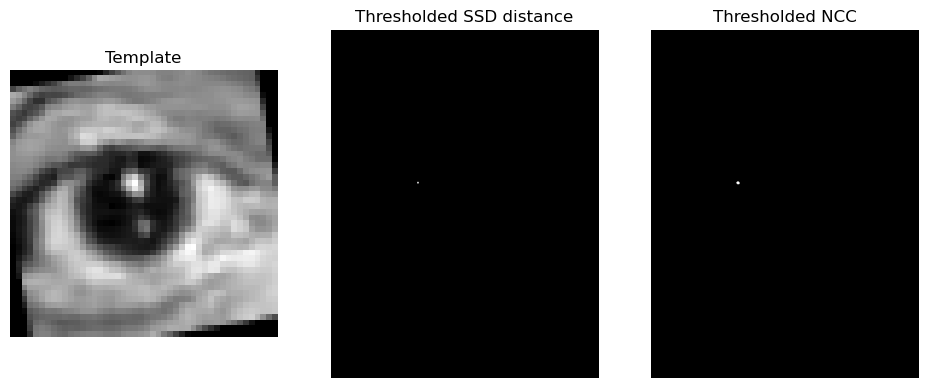

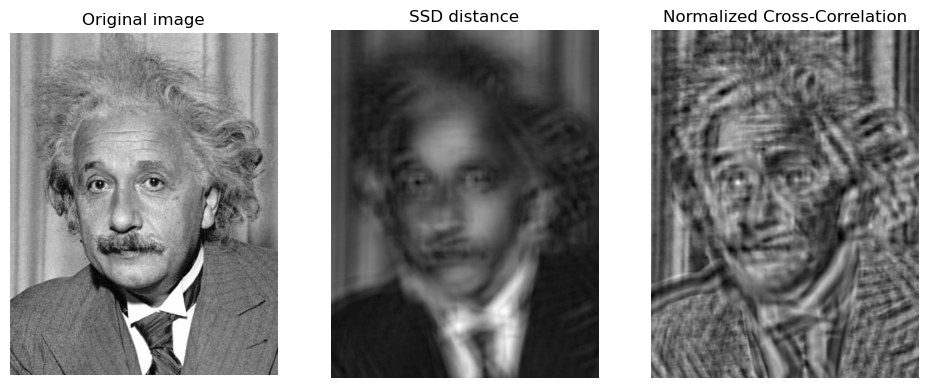

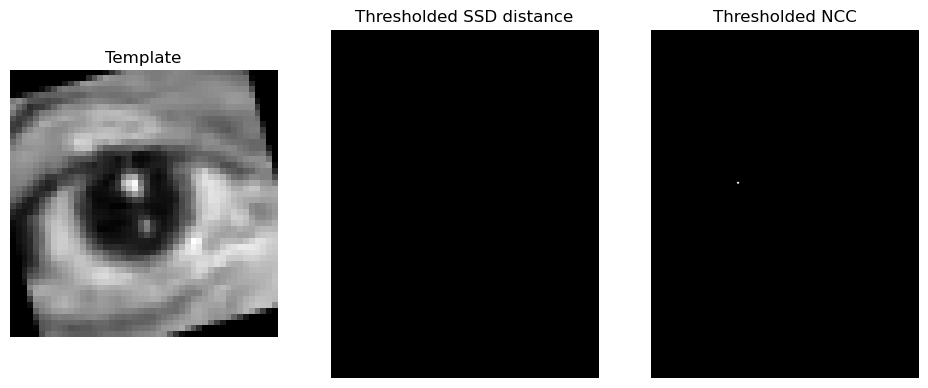

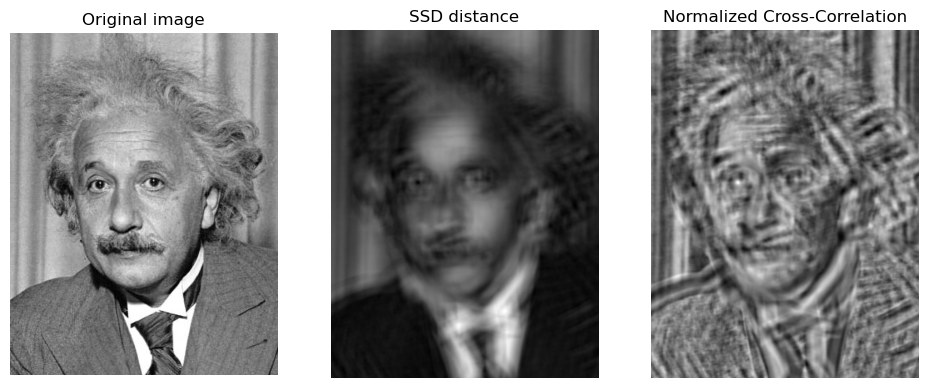

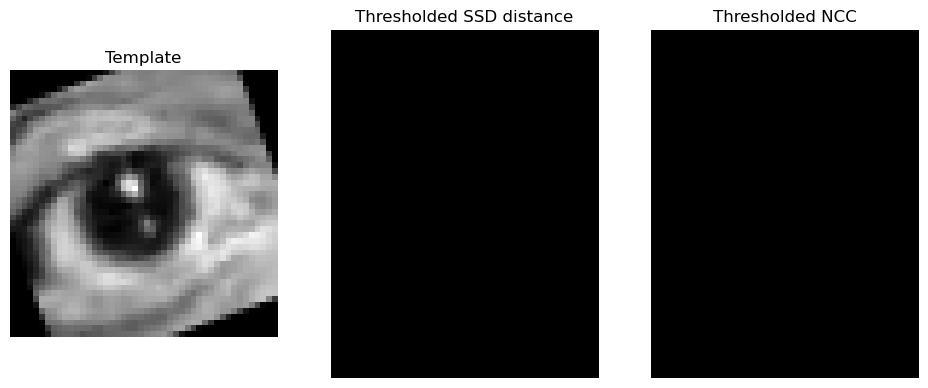

In [147]:
from skimage.transform import rotate
rotated_einstein = np.zeros(einstein.shape)
angles = [2, 5, 10, 15, 20]
for angle in angles:
    rotated_eye = rotate(eye, angle)
    ssd,ncc = compare_SSD_NCC(einstein,rotated_eye)
    get_matches(rotated_eye,ssd,ncc)

Comment the template matching process:
* Please, explain briefly the algorithm, including advantages and disadvantage
* Is the algorithms affected by contrast changes in the tempate image?
* What parameters it has and which measure for image comparisons works better.

**Answer 1**: We apply the sliding window tecnique to find the zones where a certain image is similar to a certain template (matching). To achieve it, we must define a measure of what we understand by good similarity. In this exercise we have tried 2: SSD distances and NCC. The first one is very simple and fast (only takes the sum of squared differences between pixel values) but it is very sensitive to contrast change. NCC, despite being more complicated, normalizes, for the zone where we try to find a match, the contrast of the template and the image (their mean and variance), resulting in a more robust measure against illumination changes. Nevertheless, it is not sensitive to rotations, as we are matching position of pixels matching with other pixels positions of the template.

**Answer 2**: Sure, as we mentioned above, we don't get matches with SSD, whereas with NCC everything is fine, we only get 2 matches, where the eyes are located.

**Answer3** Again, the parameters are the threshold values used to obtain the binary images (and, if wanted, the angle of rotation in this last experiment). Similarly to before, NCC has proven to be a better measure than SSD distance. We could also consider the type of distance calculation as a parameter of the algorithm.

# 2 Histogram of Oriented Gradients

In this section we will treat the following topic: HOG image descriptor. Application to person detection.

The Histogram of Oriented Gradients (HOG) feature descriptor is classical image descriptor for object detection.

Given the image `person_template.bmp` and the folder `/images/TestPersonImages/`, apply the HOG descriptor in order to detect where there is a person in the images. To this purpose, apply the "sliding window" technique. We use images from GRAZ 01 data from [INRIA datasets](http://pascal.inrialpes.fr/data/human/).

**2.1. (5 points)** Read the template (`person_template.bmp`), obtain its HOG descriptor (with the optimal parameters) and visualize it.

Help: the HOG detector function is in the skimage.feature library ([Help](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_hog.html#sphx-glr-auto-examples-features-detection-plot-hog-py)).

Obtain 2 versions of the HOG descriptor:
- With the default parameters.
- Then with 4x4 pixels per cell and 2x2 cells per block and orientations set to 8

Visualize the original image, the default values HOG descriptor and the defined parameters HOG descriptor in a 1x3 grid of images.

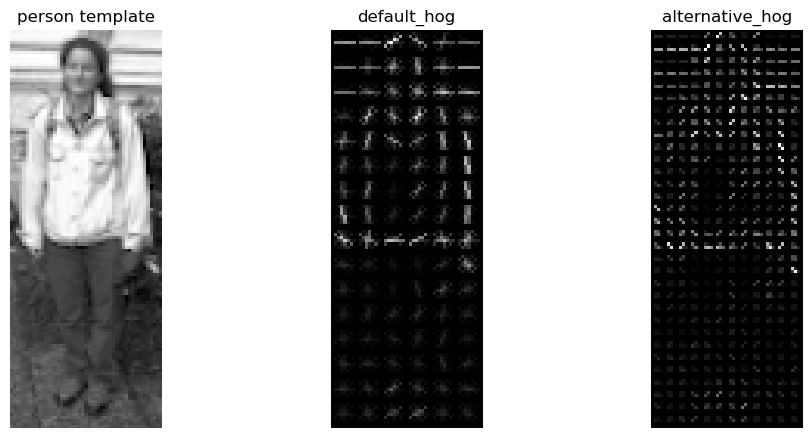

In [168]:
person_template = io.imread("images/person_template.bmp", as_gray=True)
from skimage.feature import hog

#hog_descriptor represents a feature vector that captures the distribution of local intensity gradients in an image. 
#This vector is derived from dividing the image into smaller regions called cells and computing the histograms of gradient orientations within each cell. 
#The final hog_descriptor is formed by concatenating these histograms across all cells.
hog_descriptor_1, hog_image_1 = hog(person_template, visualize=True)
hog_descriptor_2, hog_image_2 = hog(person_template, pixels_per_cell=(4, 4),
    cells_per_block=(2, 2),visualize=True)

show_images([person_template, hog_image_1, hog_image_2], ["person template", "default_hog", "alternative_hog"])

Print and explain the number of feature resulting on the default parameters HOG descriptor (4536). Break this number down, starting from the original image size.

**Below we show, in code, how the size of the HOG descriptor is determined. We compute the gradient orientations in each cell. Moreover, we consider blocks composed by several cells (and we store the orientations for each cell of the block). We overlap the blocks applying a sliding window strategy, so we have, considering  𝑏,𝑐,𝑜  the total number of blocks, cells and orientations to consider (respectively), a vector of size  𝑏·𝑐·𝑜 .**

In [170]:
#### Your solution here
print(f"Number of features for default parameters HOG descriptor: {len(hog_descriptor_1)}")

# We know this algorithm from theory:
#For a 64x128 image
#Divide the image in cells of 8x8 pixels (8x16 cells)
#Group cells into blocks of 2x2 cells (16x16 pixels) of 50% overlap 
#Total number of blocks: 7x15= 105
#Quantize the gradient orientation into 9 bins
#Concatenate histograms: 105 x 4 x 9 = 3780 feature vector

# Original image size
m,n = person_template.shape

# Default parameters in hog()
orientations = 9
pixels_per_cell = 8 # Squared
cells_per_block = 3 # Squared

# nº cells in each axis
cell_x = m // pixels_per_cell
cell_y = n // pixels_per_cell

# nº blocks (applying sliding window: nº cells - cells_per_block + 1 in each axis)
blocks = (cell_x-cells_per_block+1)*(cell_y-cells_per_block+1)

# Feature vector size: nº blocks * cells_per_block**2 (in each axis) * nº orientations
print(f"Theoretical size of feature vector: {blocks*cells_per_block*cells_per_block*orientations}")

Number of features for default parameters HOG descriptor: 4536
Theoretical size of feature vector: 4536


**2.2. (15 points)** Apply the HOG descriptor on the complete set of images for person detection.

a) Read images from the folder "TestPersonImages", slide a window on each image, obtain the HOG descriptor and compare to the HOG descriptor of the person template.

b) Visualize the location in the image that is the most similar to the person template using the distance between the template and test image descriptors.

Display the results of every person detection following this format:

<img src="images/hog.png" width="400" height="200">

2.2731951243113064


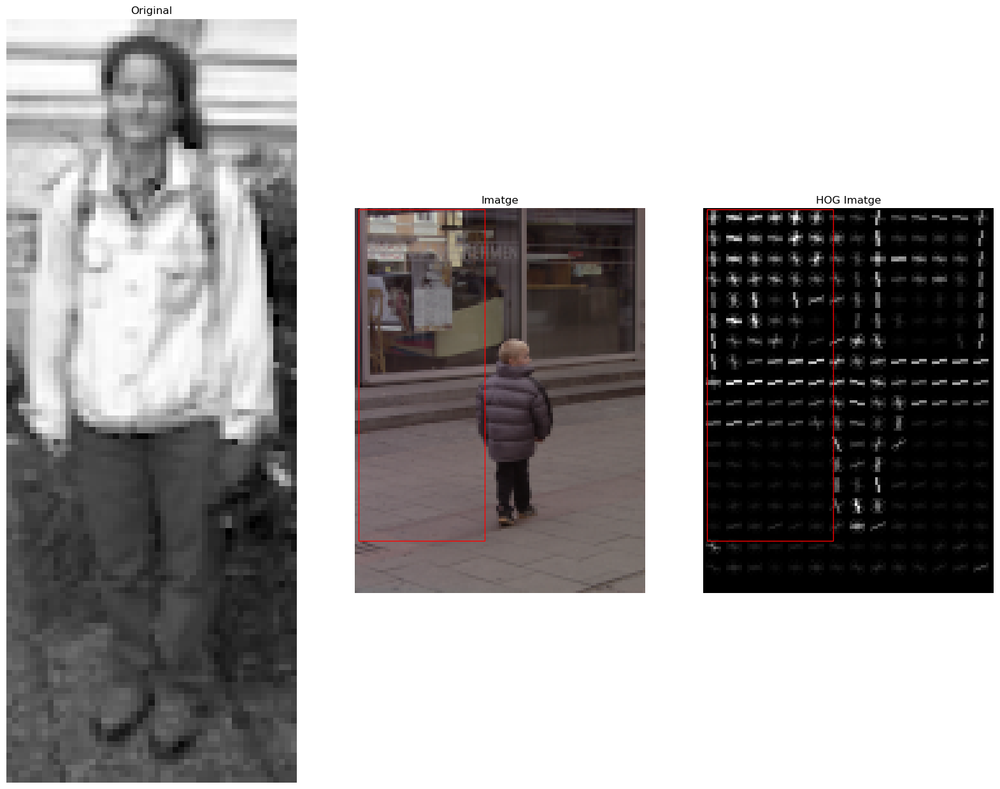

2.273632867462264


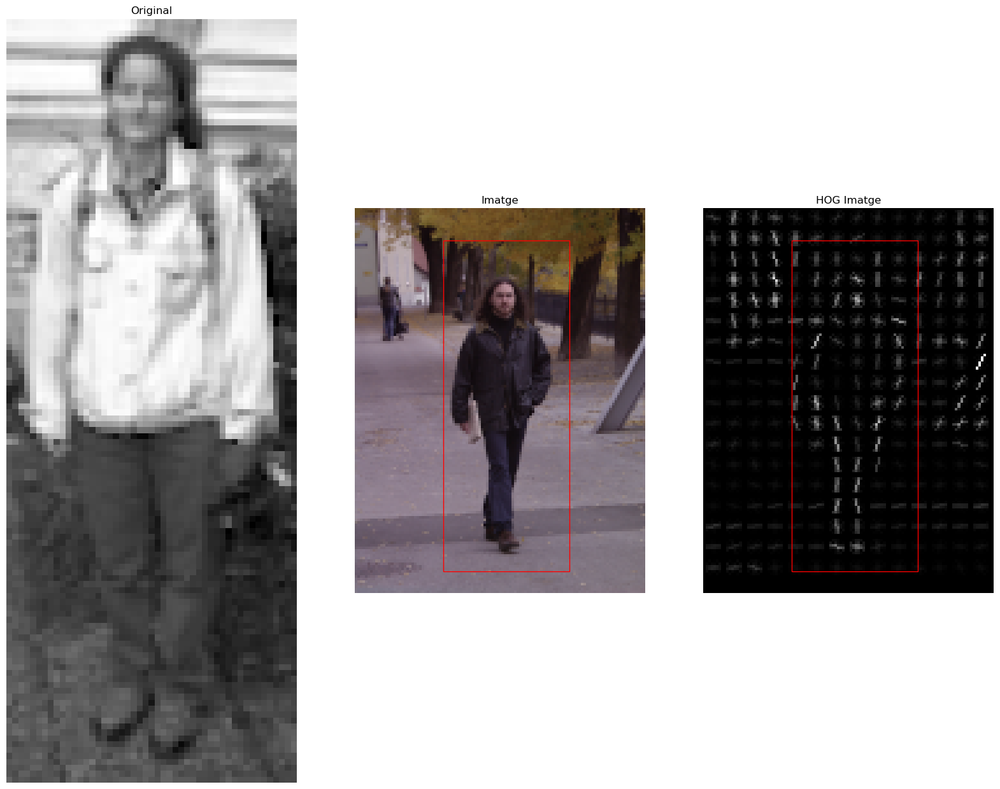

2.272993789902052


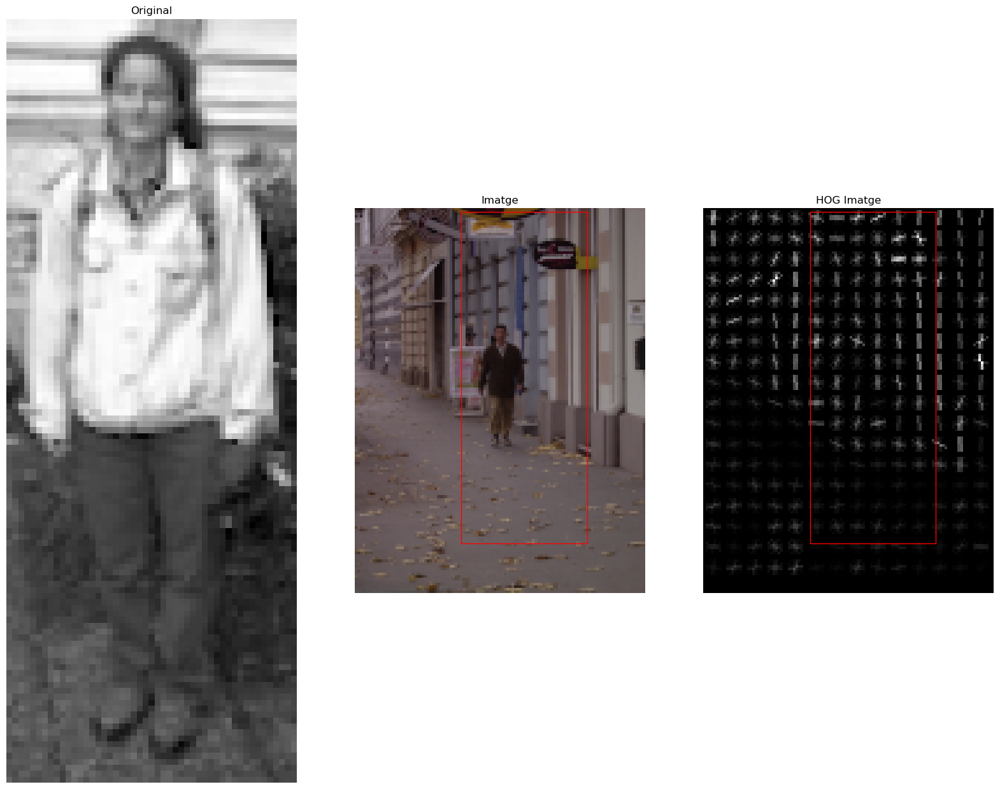

2.269474939012313


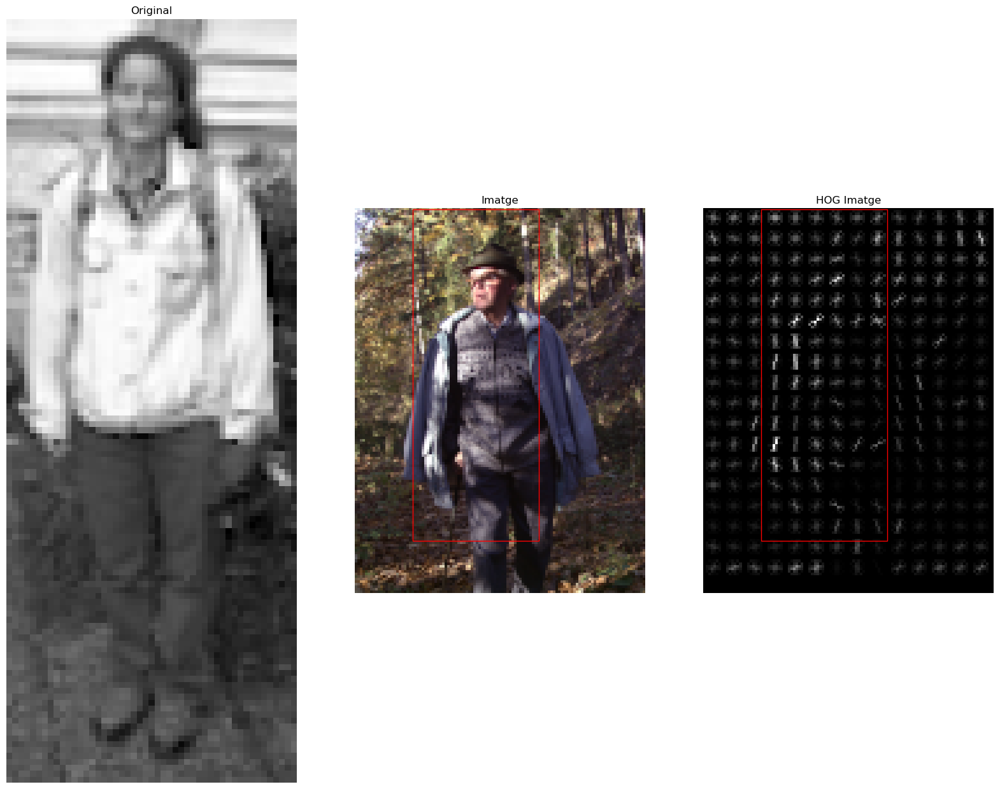

2.272636799455854


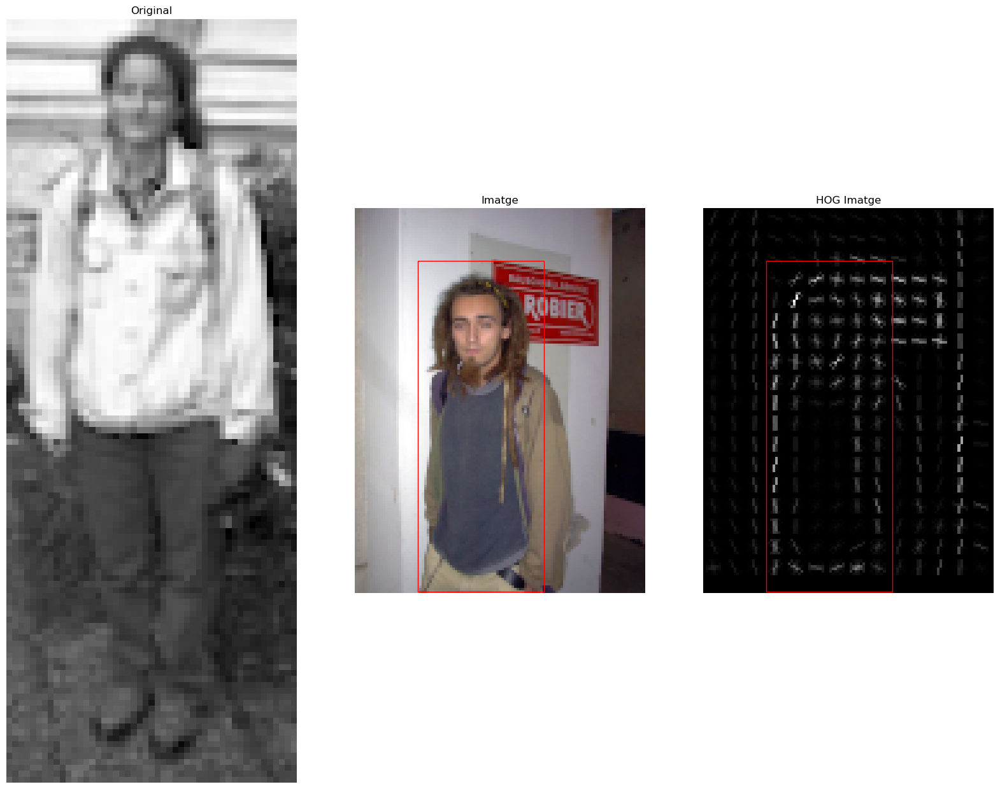

2.2722616623491496


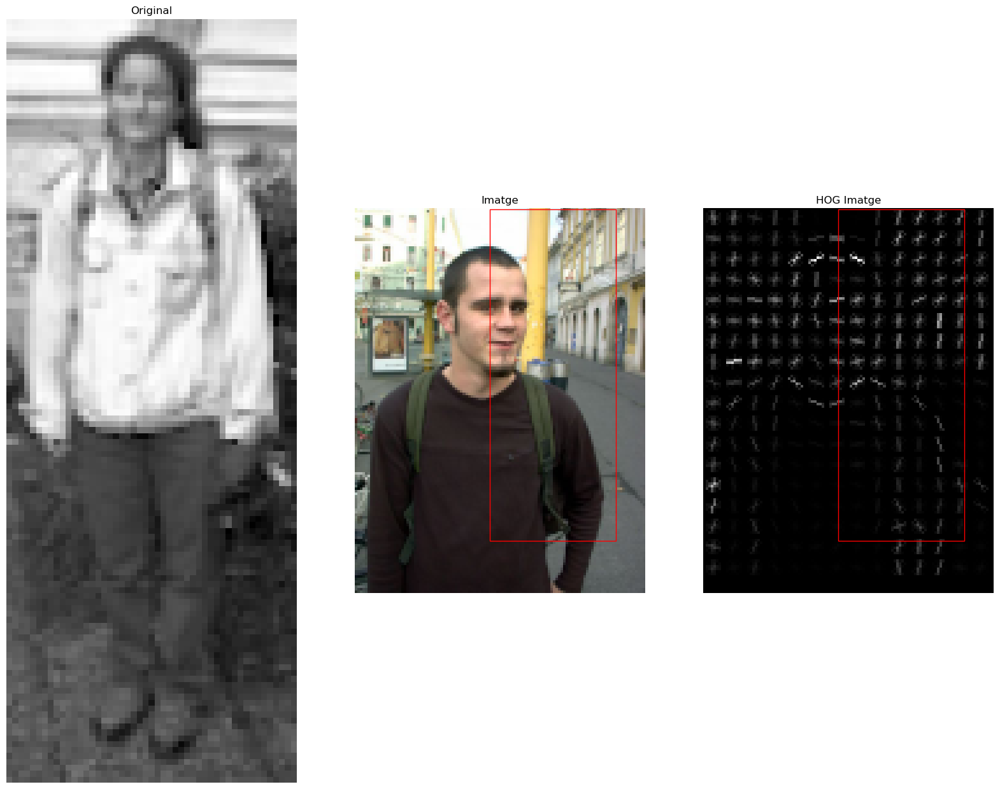

2.268319849789061


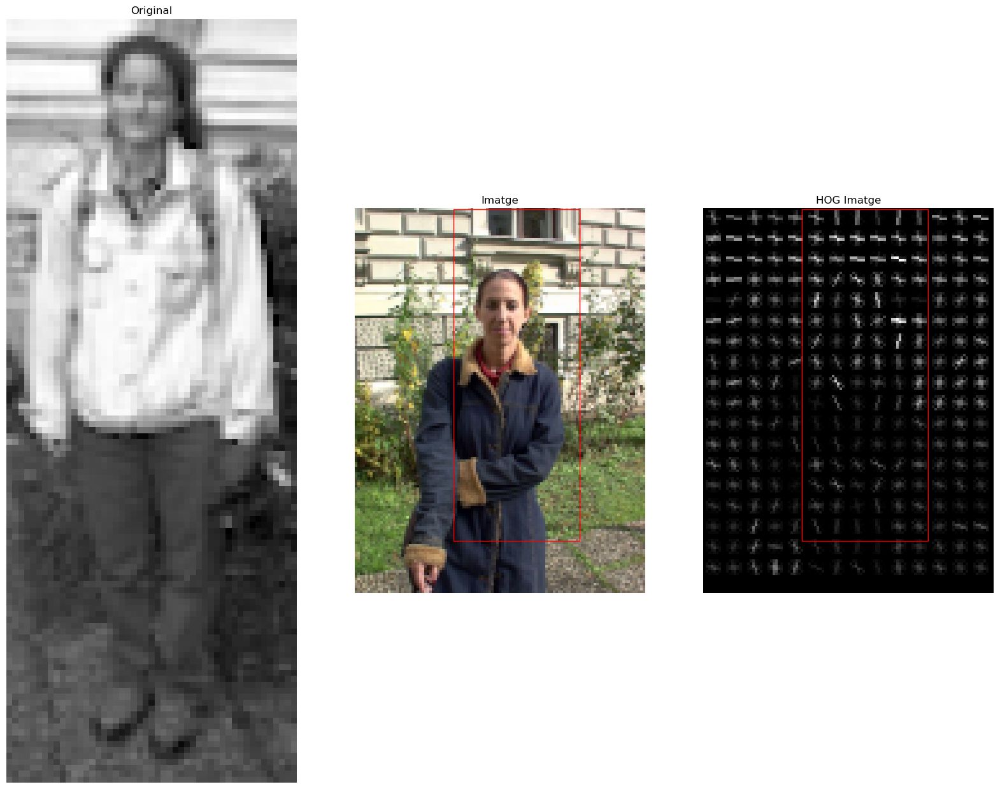

2.2713616610168503


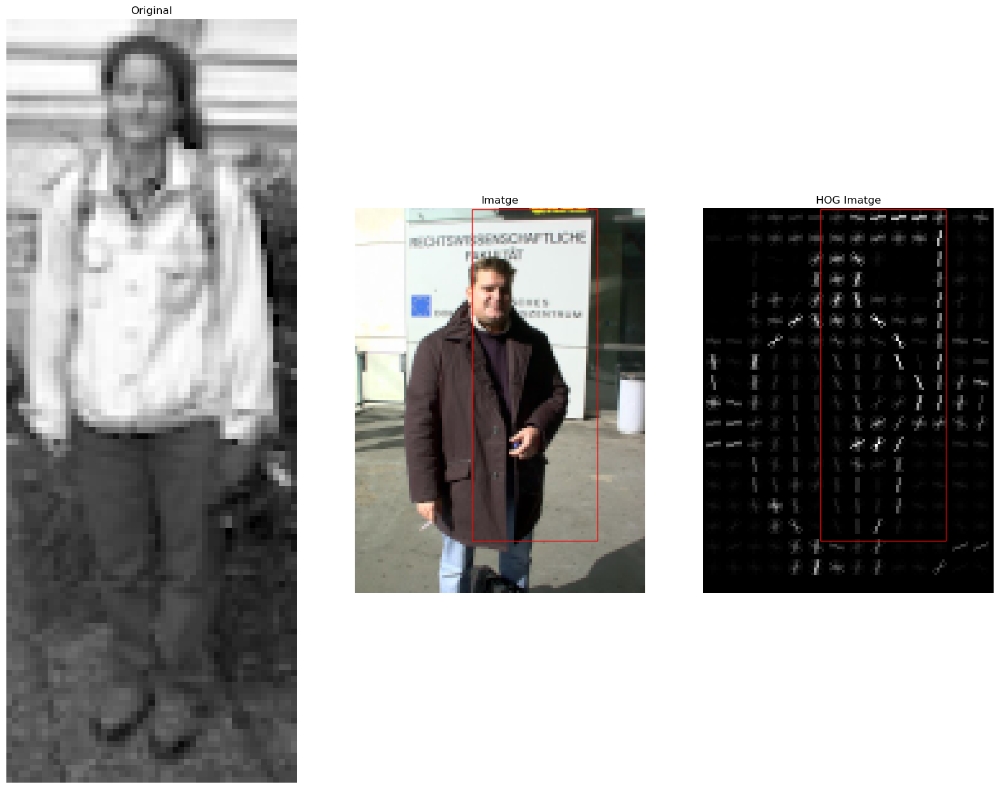

2.273127375024323


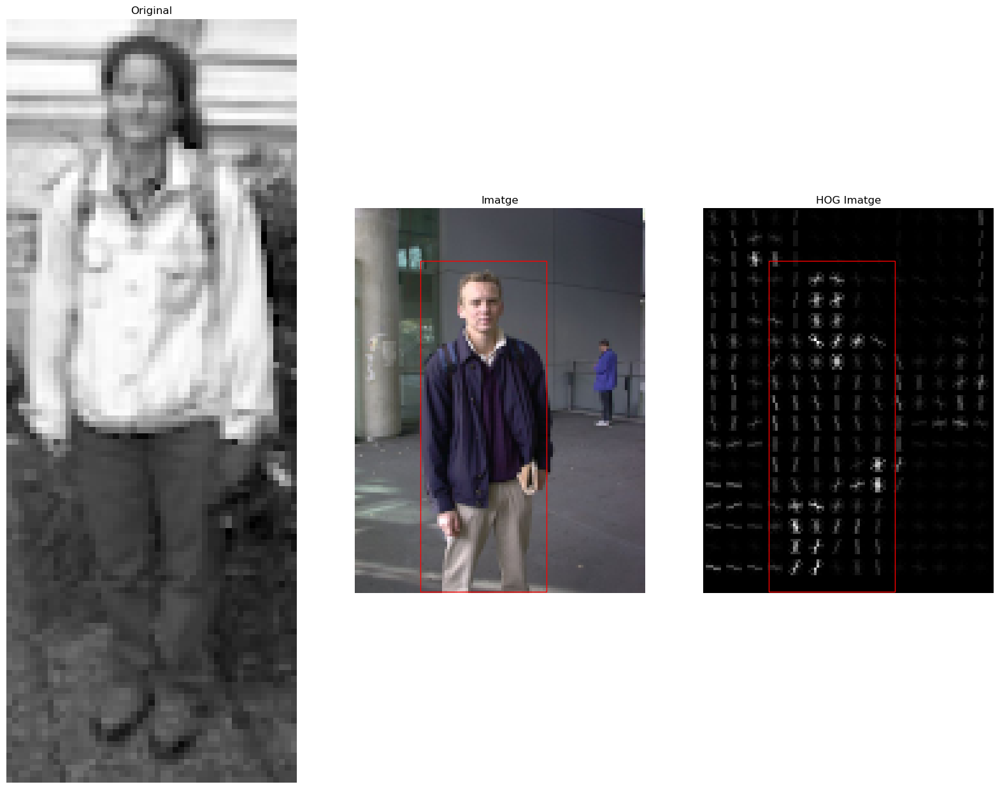

2.27438149544673


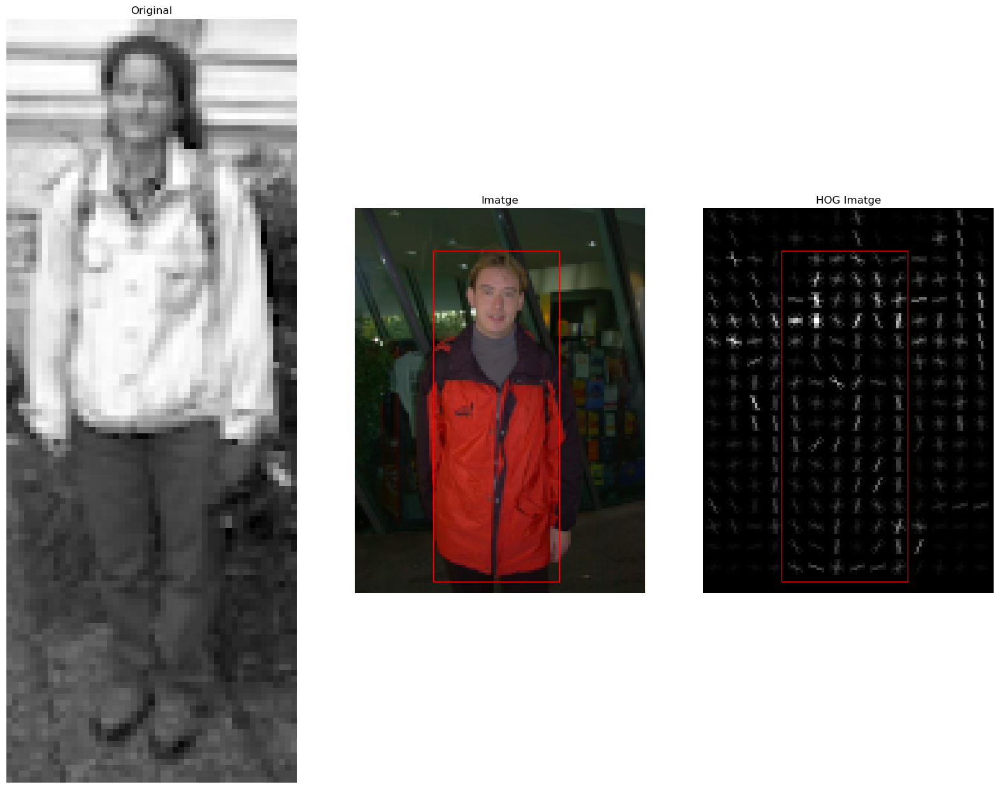

2.27367146939297


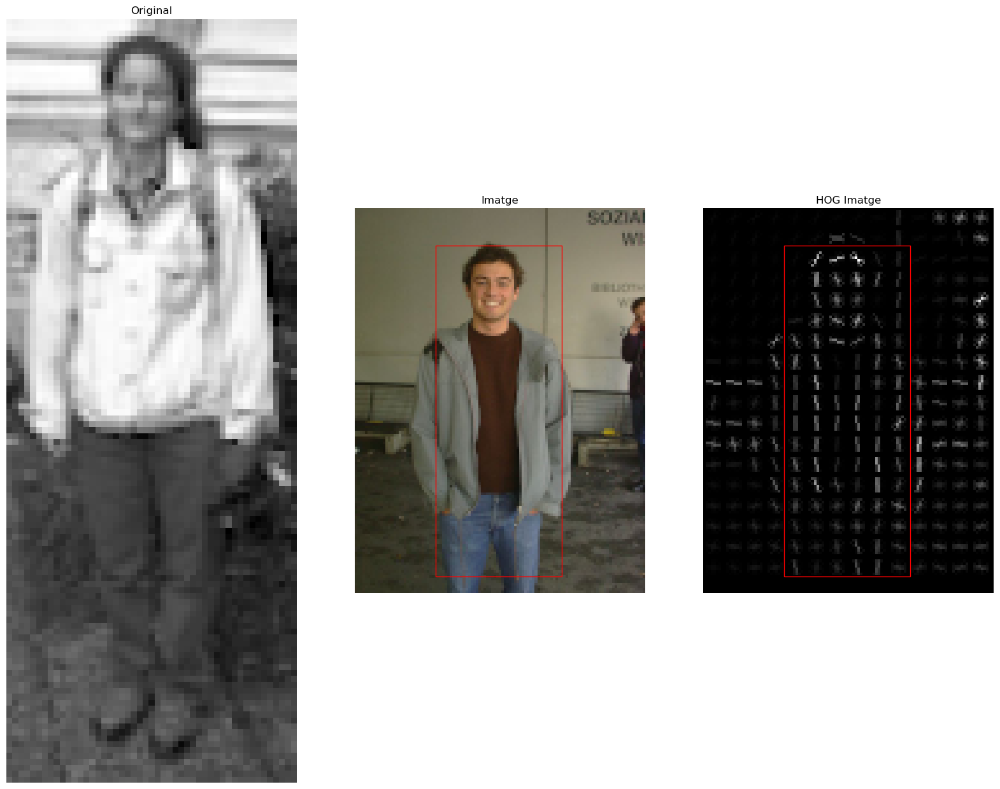

2.272280903521471


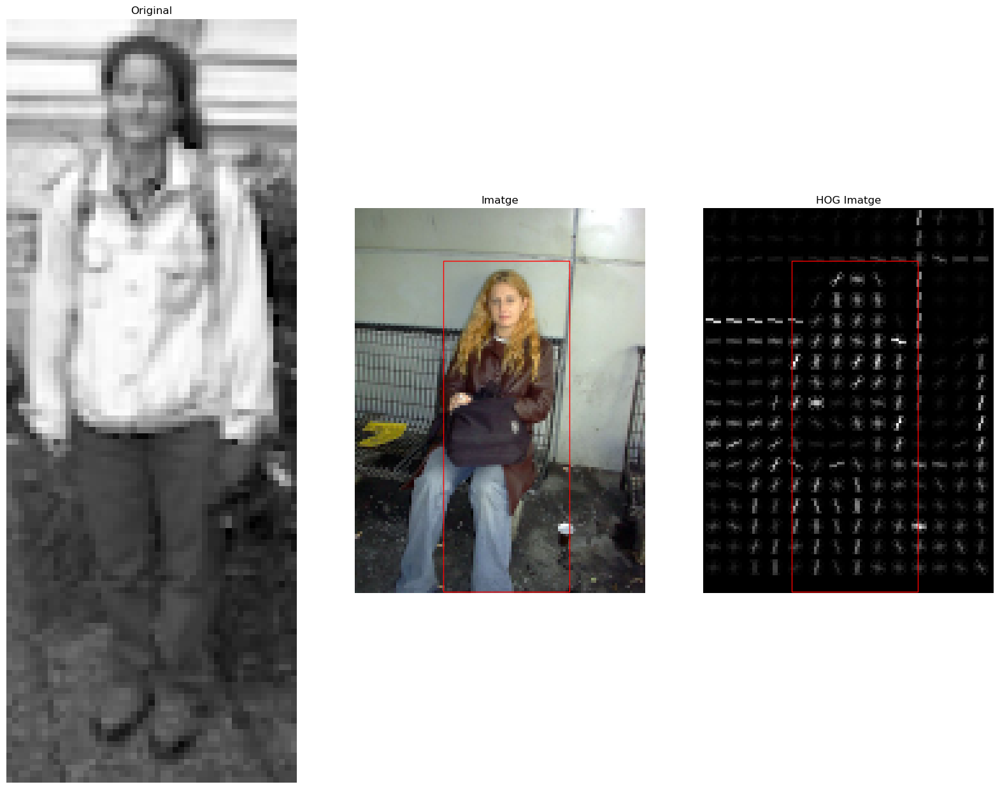

2.2712649491376533


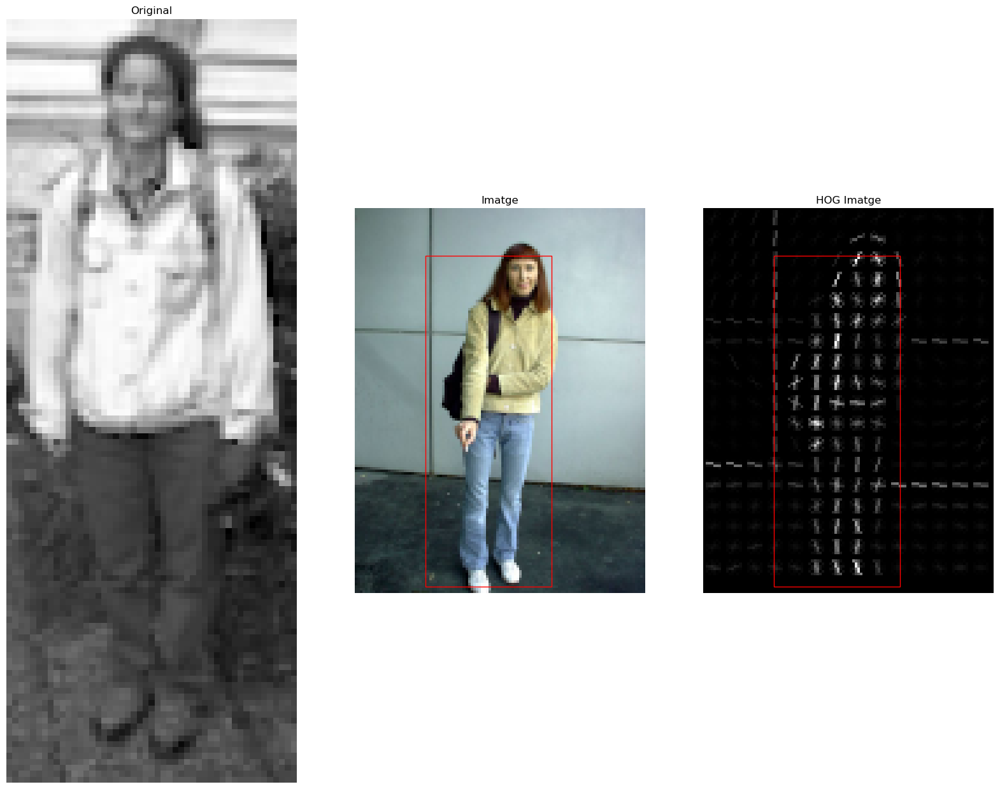

2.2699820885747606


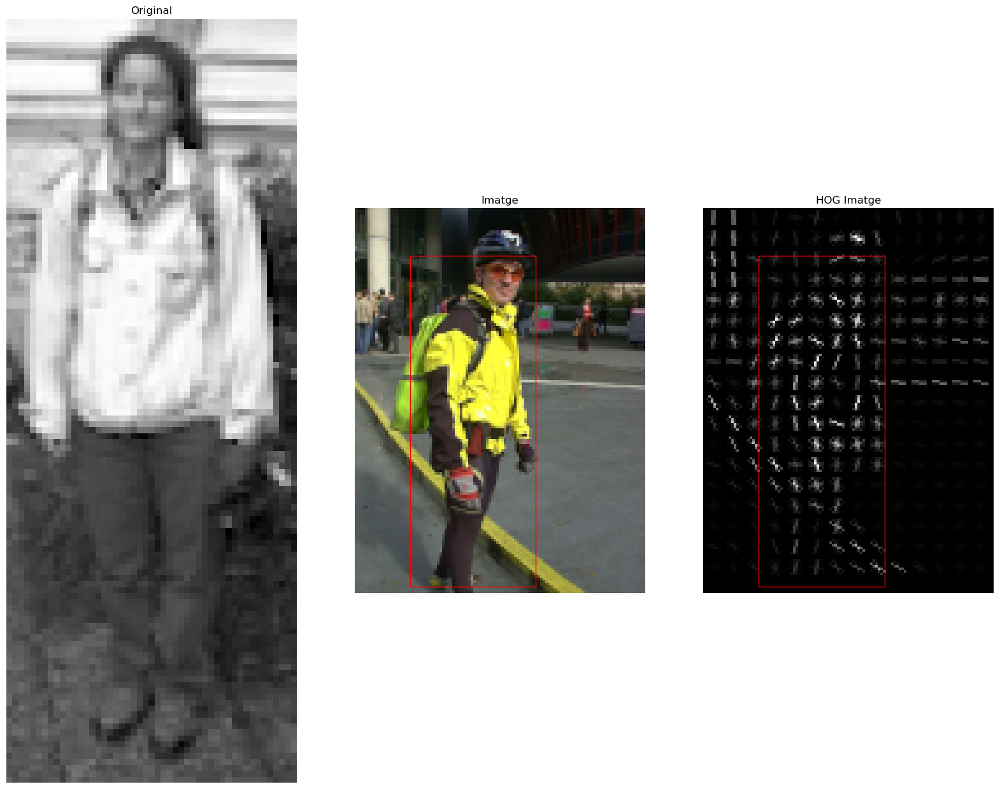

2.27000064511899


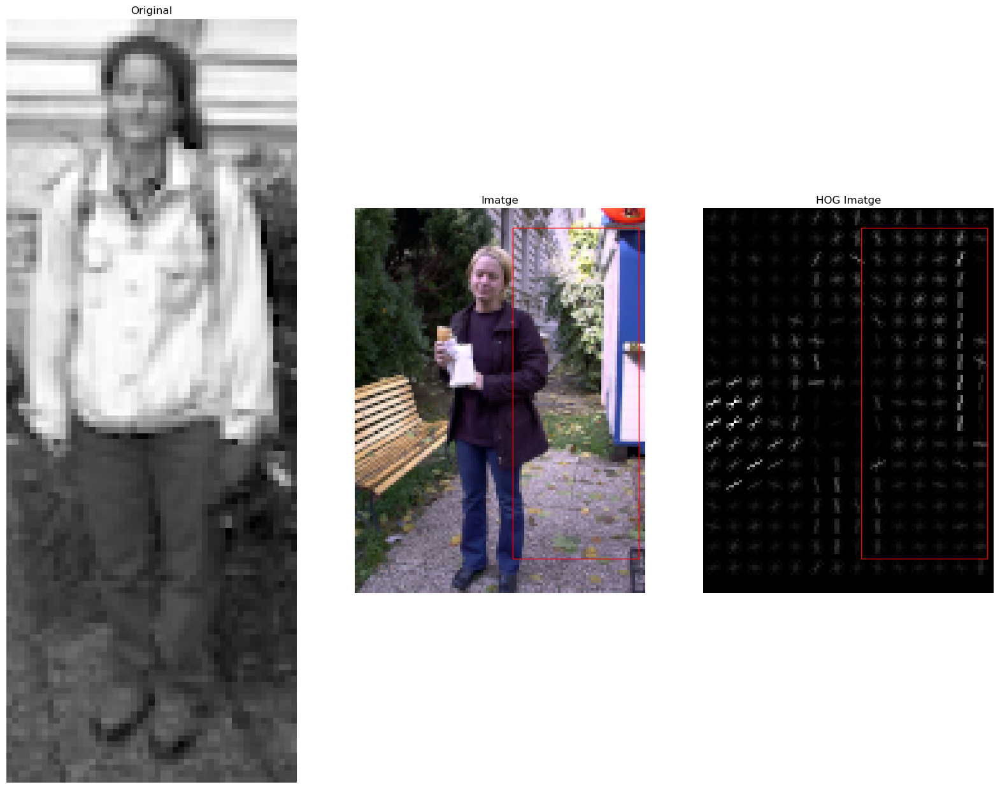

In [208]:
from skimage import img_as_float # Needed for data conversion (from uint8 to float)
from skimage.color import gray2rgb, rgb2gray # Color conversion from gray, to gray
from skimage.exposure import rescale_intensity # [0,1] normalization
import matplotlib.patches as patches

def viualizeHOG(image1,image2,image3,patch1,patch2):  
    
    figures, ax = plt.subplots(ncols=3, figsize=(20,20))
    ax[0].imshow(image1, cmap='gray')
    ax[0].set_title('Original')
    ax[0].axis('off')
    ax[1].imshow(image2, cmap='gray')
    ax[1].add_patch(patch1)
    ax[1].set_title('Imatge')
    ax[1].axis('off')
    ax[2].imshow(image3, cmap='gray')
    ax[2].set_title('HOG Imatge')
    ax[2].add_patch(patch2)
    ax[2].axis('off')

    plt.show()


images = io.ImageCollection('./images/TestPersonImages/*.bmp')

Hp, Wp = person_template.shape

hogPerson = hog(person_template, orientations=8,pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True)[1]
Hhp, Whp = hogPerson.shape

for imOr in images:
    # We turn it into a float gray image
    im = img_as_float(rgb2gray(imOr))
    
    hogIm = hog(im, orientations=8, pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True)[1]
    Hh, Wh = hogIm.shape

    coordList = {} 
    
    for i in range(Hh-Hhp):
        for j in range(Wh-Whp):
            # Where is the HOG in the image
            subIm = im[i:i+Hhp, j:j+Whp]  
            hogSubIm =  hog(subIm, orientations=8,pixels_per_cell=(8, 8), cells_per_block=(2, 2), visualize=True)[1]
            #Apply norm to find the best distance and whe put the same intensity to both images
            dist = np.linalg.norm(rescale_intensity(hogSubIm, in_range=(0,255)) - hogPerson)  
            coordList[dist] = [j, i]
    
    coordMin = coordList[min(coordList.keys())] #coordinates of the min distance
    # Generate rectangles where the similarities of both images are
    rectImg = patches.Rectangle(coordMin, Wp, Hp, edgecolor='r', facecolor='none')
    rectHog = patches.Rectangle(coordMin, Wp, Hp, edgecolor='r', facecolor='none')
    
    viualizeHOG(person_template, imOr, hogIm, rectImg, rectHog)   

Count on how many images were the persons detected correctly and discuss the failures.
What do you think can be the reasons for the failures?

**Answer**: Answer: 10 out of 15 were detected correctly. Note that, for the failures, the backgrounds give multiple orientations not related to a person (it might be the reason why they are not detected). On the other hand, the 6th image shows a partial person (without his legs), making us impossible to apply the lower-body orientations of the template image (looking the HOG images, we see factors like body position and clothes affect as well).

Test several values of the parameters (``orientations``, ``pixels_per_cell``, ``cells_per_block``) to show which are the optimal values for the person detection problem. Note: since you are testing several values and not the whole universe, this question might have different solutions, make sure to try several to at least be directionally correct

**Answer**: During this exercice we have proved a lot of differents values but finally we thing that (orientations: 8 ,pixels_per_cell = (8, 8),cells_per_block(2, 2) are the better ones.

Comment the object detection process:
* Please, explain briefly the algorithm, including advantages and disadvantage
* Do you see any advantages of the HOG-based object detector compared to the template-based object detection? (The answer should be up to 10-15 lines).

The algorithm gets an image descriptor based on the gradient orientations, giving features of local shape and appearance. The gradient magnitude is sensitive to contrast changes, but its direction is preserved. Therefore, if we divide the images in cells and count the occurrences of the gradient orientation in each one, we will get a histogram that represents, locally, the image. This is HOG (Histogram of Oriented Gradients). To be less sensitive to the images changes in illumination, we normalize the image contrast by blocks (groups of cells).
Hence, we get a descriptor which can be used in several applications (pedestrian detection, like we are doing), image retrieval and classification... Note that, however, it is sensitive to occlusion and if we only have one template we may not detect small variations of the position (or different clothes and angles).
Compared to template-based object detection, HOG works with the descriptors, which are smaller (in shape) than the original images, leading to faster computations. Moreover, since a block normalizes its contrast, it is less sensitive to illumination changes than with SSD distance. Finally, it reduces the effect caused by small rotations due to the grouping in bins (for 9 orientations, angles in the range (0,45) go to the same one, so the 20º rotation of the previous exercise should not be an issue here).

# 3 ORB feature detector and binary descriptor

Let us consider the problem of feature extraction that contains two subproblems:
- feature location,
- image feature description.

Let us focus on ORB, an approximation of SIFT method, and analyse if ORB is  scale and rotation invariant, a property that is very important for real-time applications.

**Hint:** `ORB` is a function within the module `skimage.feature`
                             
**Help**: We suggest to have a look at the [ORB example](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_orb.html) how to compute the ORB descriptors and find the descriptors match. You can use the function match_descriptors from `skimage.feature` module in order to compute and show the similar detected descriptors of the given images.

**3.1 (10 points)** First, detect the censure in the image `starbucks4.jpg`. Analyze and discuss the effect of different values of the parameters in censure function. (this is a separate funcion from ORB)

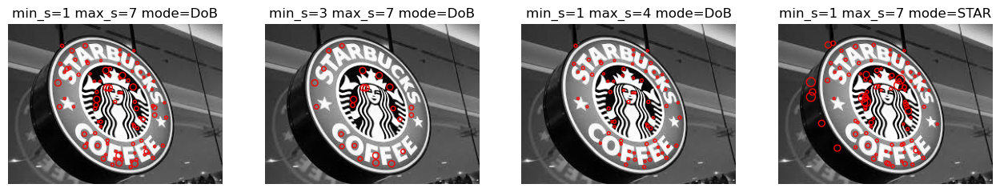

In [218]:
# Your solution here
from skimage.feature import CENSURE # Function asked

# Encapsulation for further usage in the optional exercise
def CENSURE_experiment(img):
    # Values for min_scale, max_scale, mode parameters
    params = [[1,7,'DoB'],[3,7,'DoB'],[1,4,'DoB'],[1,7,'STAR']]

    # Experiment
    fig = plt.figure(figsize=(20,30))
    #For each set of parameters we see the results
    for i,(m,M,mode) in enumerate(params):
        # Detect features
        detector = CENSURE(min_scale=m, max_scale=M, mode=mode)
        detector.detect(img)
        #Now, detector will have an attribute called keypoints that contain the detected keypoints

        # Visualization
        fig.add_subplot(5, 5, i+1)
        plt.title(f"min_s={m} max_s={M} mode={mode}")
        plt.imshow(img, cmap='gray')
        #scatter: small, dispersed amount of something
        #detector.keypoints[:, 1] and detector.keypoints[:, 0]: Represent the y (vertical) and x (horizontal) coordinates of the keypoints 
        #2**detector.scales represente the size of the scatter plots, proportional to the detector scales
        #facecolors='none': This specifies that the points on the scatter plot should have no fill color (transparent).
        plt.scatter(detector.keypoints[:,1], detector.keypoints[:,0], 2**detector.scales, facecolors='none', edgecolors='r')
        plt.axis("off")
    plt.show()
    
# Load image
starbucks4 = io.imread('images/starbucks4.jpg', as_gray=True)

# Apply CENSURE
CENSURE_experiment(starbucks4)

**3.2 (10 points)** Detect the correspondences between the model image `starbucks.jpg` with the scene image `starbucks4.jpg`. You can adapt the code from the [ORB example](http://scikit-image.org/docs/dev/auto_examples/features_detection/plot_orb.html).

Define a function get_ORB implementing the algorithm in order to be able to apply it on different images. Comment the code in detail.

**Hint: If the function plot_matches() gives you an error you can use the plot_matches_aux() at the end of this file.**

Analyze and discuss the effect of different values of the parameter `max_ratio` in the match_descriptors function.


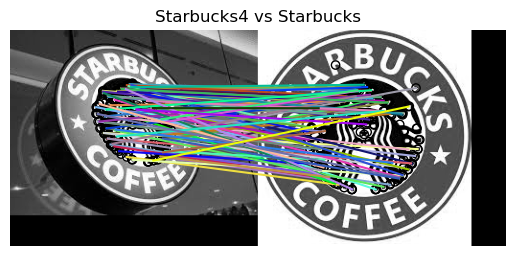

84

In [256]:
from skimage.feature import match_descriptors, ORB, plot_matches


def get_ORB(new_im, model, title, max_ratio=1.0):

    descriptor_extractor = ORB(n_keypoints=200)

    descriptor_extractor.detect_and_extract(model)
    descriptors1 = descriptor_extractor.descriptors
    keypoints1 = descriptor_extractor.keypoints

    descriptor_extractor.detect_and_extract(new_im)
    descriptors2 = descriptor_extractor.descriptors
    keypoints2 = descriptor_extractor.keypoints

    #max_ratio:Maximum ratio of distances between first and second closest descriptor in the second set of descriptors. This threshold is useful to filter
    #ambiguous matches between the two descriptor sets. The choice of this value depends on the statistics of the chosen descriptor, e.g.,
    #for SIFT descriptors a value of 0.8 is usually chosen
    matches = match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=max_ratio)


    plot_matches(plt, model, new_im, keypoints1, keypoints2, matches)
    plt.axis('off')
    plt.title(title)
    plt.show()
    
    return len(matches)
    
starbucks = io.imread("images/starbucks.jpg", as_gray=True)
get_ORB(starbucks, starbucks4, "Starbucks4 vs Starbucks")


Repeate the experiment comparing the `starbucks.jpg` image as a model, and showing its matches to all Starbucks images, sorting them based on their similarity to the model. Comment when does the algorithm work better.

**Answer**: As we can see below, the Starbucks images sorted by similarity to the model are: starbucks6, starbucksCup, starbucks2, starbucks4, starbucks5. The highest number of coincidences corresponds to the Refuge From The Cuts image (starbucks5), since they are equal excluding the letters and the logo pose.

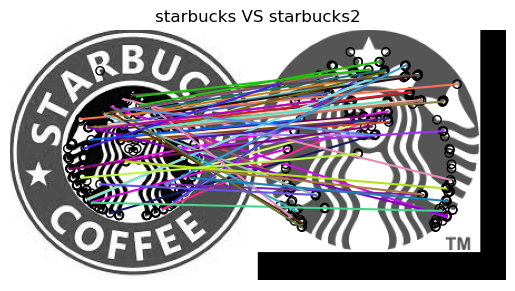

Number of matches: 66


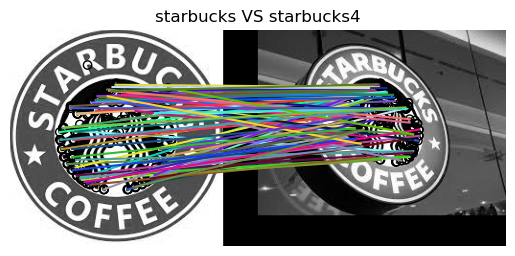

Number of matches: 84


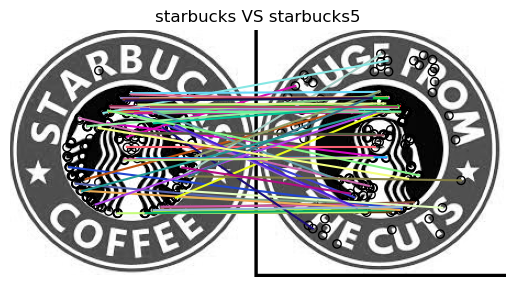

Number of matches: 72


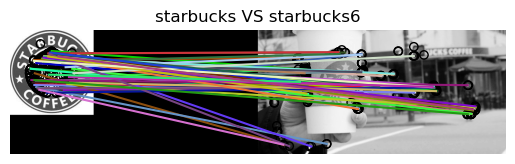

Number of matches: 61


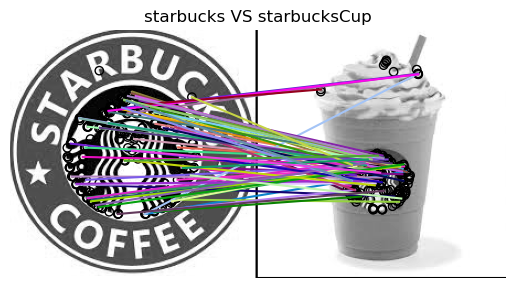

Number of matches: 69

Scenes sorted by nº matches: ['starbucks6', 'starbucks2', 'starbucksCup', 'starbucks5', 'starbucks4']



In [275]:
def ORB_matches_experiment(scenes, model, scenes_titles, model_title):
    n_matches = []
    for im,t in zip(scenes,scenes_titles):
        #get_ORB calculates and plot matches and return the lenth of this matches variable (number of matches)
        matches = get_ORB(im, model, f"{model_title} VS {t}")
        print("Number of matches:", matches)
        n_matches.append(matches)

    # Scenes sorted by similarity to model, in ascending order
    print(f"\nScenes sorted by nº matches: {[scenes_titles[i] for i in np.argsort(n_matches)]}\n")
    

# We Load all starbucks images
starbucks2 = io.imread('images/starbucks2.png', as_gray=True)
starbucks5 = io.imread('images/starbucks5.png', as_gray=True)
starbucks6 = io.imread('images/starbucks6.jpg', as_gray=True)
starbucksCup = io.imread('images/starbucksCup.jpg', as_gray=True)

# Scenes and titles
scenes = [starbucks2, starbucks4, starbucks5, starbucks6, starbucksCup]
titles = ['starbucks2', 'starbucks4', 'starbucks5', 'starbucks6', 'starbucksCup']

# Compare Starbucks images with model
ORB_matches_experiment(scenes, starbucks, titles, 'starbucks')

**3.3 (5 points)** Repeat the experiment:
- Changing the orientation of the model image by rotating it and comparing it with its original version. Help: you can use the rotate() function from skimage.transform
- Change the scale and orientation of the scene image and compare it with the model image.

**Help:** To do so, you can use the function given below as example:

```
import transform as tf
rotationdegrees = 180
img_rotated = tf.rotate(image2transform, rotationdegrees)
```

or

```
tform = tf.AffineTransform(scale=(1.2, 1.2), translation=(0, -100), rotation=0.5)
img_transformed = tf.warp(image2transform, tform)
```

Model rotation


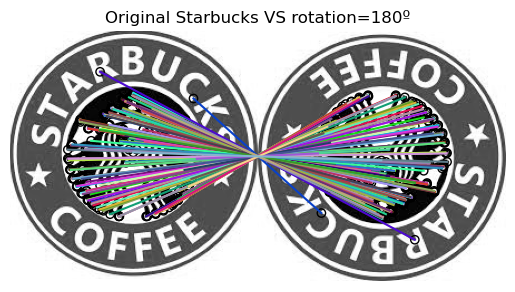

Number of matches: 199

Scene rescaling & rotation:


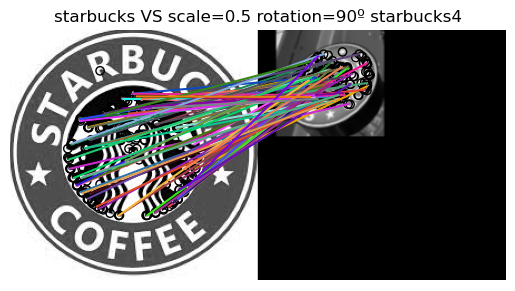

Number of matches: 75


In [277]:
from skimage.transform import rotate, rescale # Needed for rotation + rescaling

#Rotation
angle = 180
print("Model rotation")
matches = get_ORB(rotate(starbucks,angle), starbucks, f"Original Starbucks VS rotation=180º")
print("Number of matches:", matches)

#Reescaling and rotation of starbucks4
angle2 = 90
scale = 0.5
print(f"\nScene rescaling & rotation:")
new_scene = rotate(rescale(starbucks4,scale), angle2)
matches2 = get_ORB(new_scene, starbucks, f"starbucks VS scale=0.5 rotation=90º starbucks4")
print("Number of matches:", matches2)


**(Optional)** Repeat the experiment (3.1 to 3.3) with a new group of images. You could use Coca-Cola advertisements or from another famous brand, easily to find on internet.


**3.4 (5 points)** Analysis of the applied techniques and results

- What are the advantages of the ORB object detection with respect to the HOG and template object detector?

- What would happen if you analyse an image that does not contain the Starbucks logo?

- Could you think of ways of defining a quality measure for the correspondance between two images? (no need of implementing it)

**Answer 1**: ORB allows us to identify the rellevant points of an image and to know where they are even if we change the perspective or we rotate/rescale it (numbers vary more when rescaling than when rotating, since ORB is rotation invariant). We think that this is something that tells ORB apart from HOG and the template object detector, which are not rotation invariant (although we have mentioned the former is less sensitive to rotation than the latter, for big angles we have problems). Moreover, it detects objects globally (by comparing all the HOG model with the HOG of the image wanted), whereas ORB only works with feature points. This means we can find people even if they are in a different position with respect to the model (we recall that in these situations HOG has proven to work poorly when working with a single model).

**Answer 2**: For an image without the Starbucks logo we will get, probably, some matches (since, by default, the max_ratio parameter is 1). We can easily solve this changing the threshold (see code below).

**Answer 3**: A quality measure for the correspondance between 2 images should consider, in our opinion, the number of matches and the value of the max_ratio parameter from which we start to obtain them. The higher that value, the less reliable the matches are. If we ponderate in some way this information with the number of matches obtained, we can compare correspondances between 2 images and a model to determine which one is similar to it. For example, in the code below, we get matches between coke4 and starbucks from max_ratio = 0.85, whereas with starbucks4 we got them for max_ratio = 0.8 (see exercise 3.2).

Another good parameter could be the % of matches comparing with the number of critical points found.

# 4. SIFT

**4.1 (5 points)** Now use SIFT to the same problem statement as 3.2 exercise, make sure to show the results with all starbucks images provided. For now, you can use the default parameters of SIFT.
* Compare the results and the running time of both algortihms.
* Which one works best on this case?

ORB:


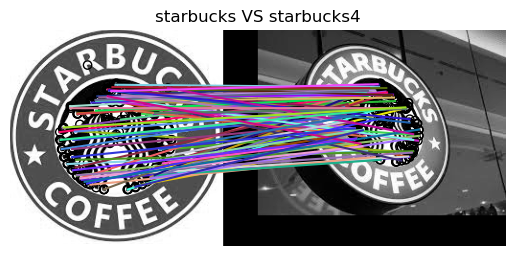

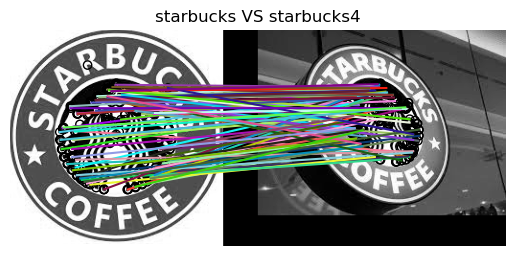

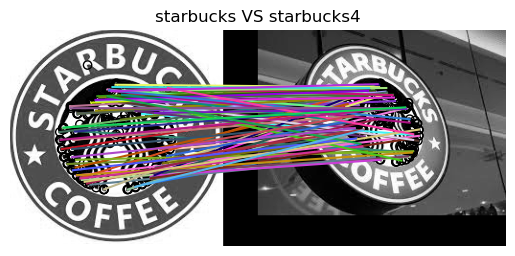

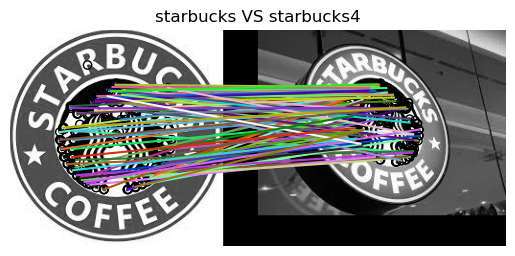

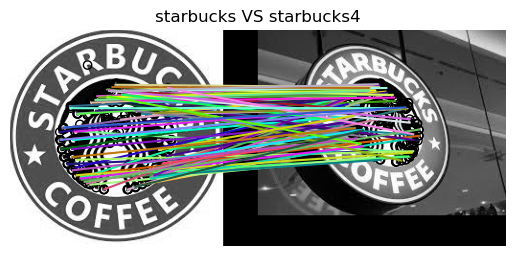

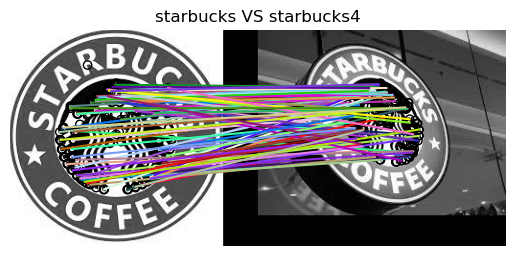

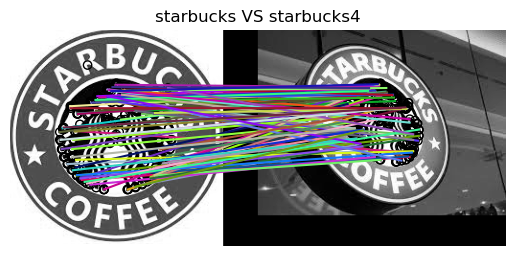

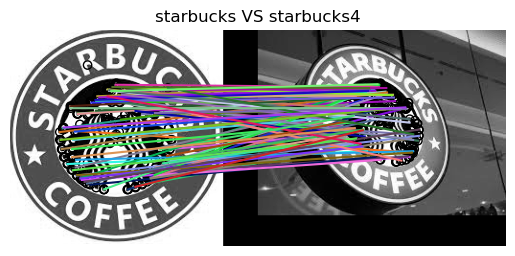

1.23 s ± 279 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

SIFT:


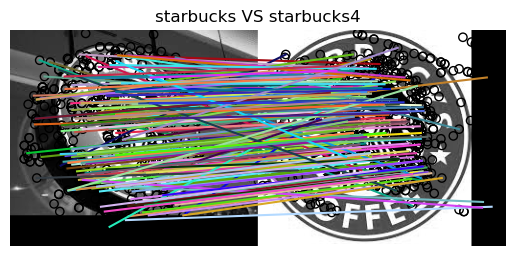

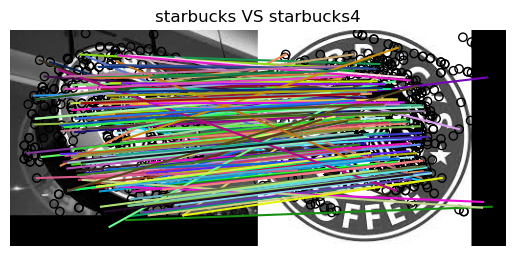

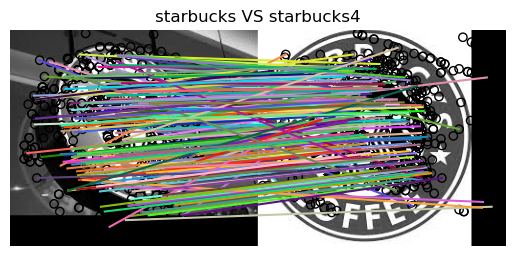

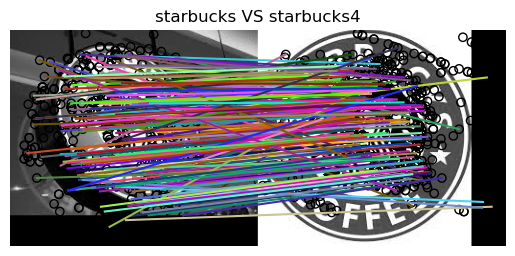

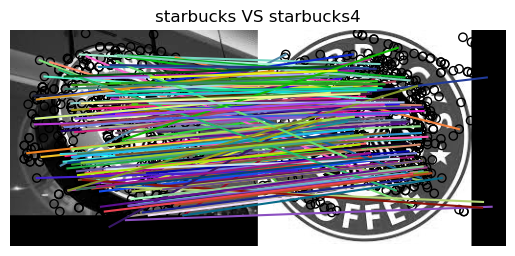

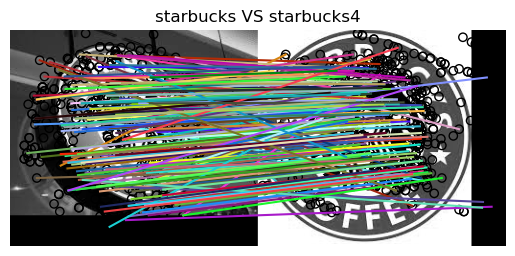

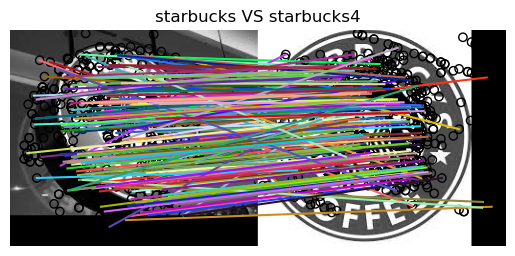

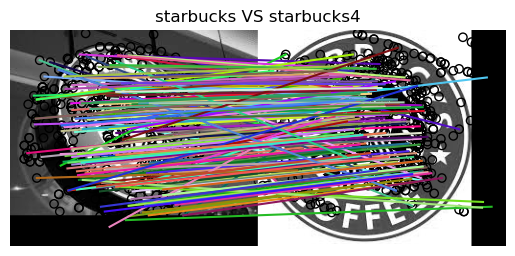

2.11 s ± 502 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


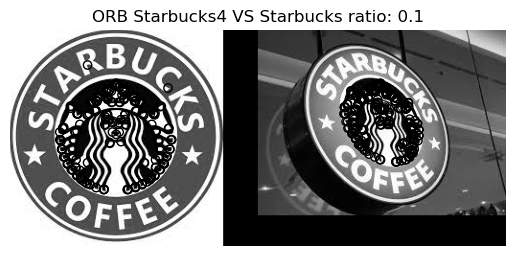

Number of matches:  0


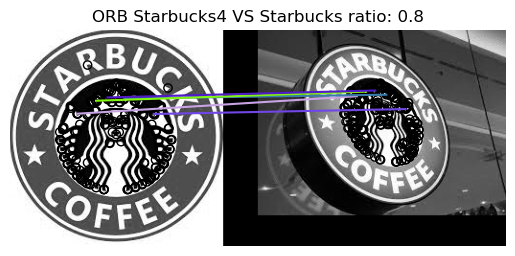

Number of matches:  5


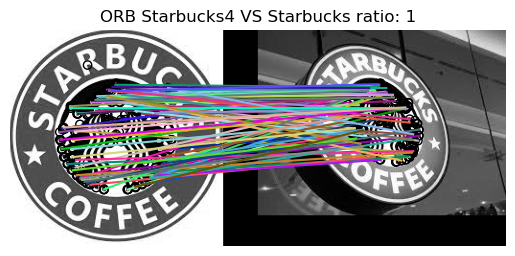

Number of matches:  84


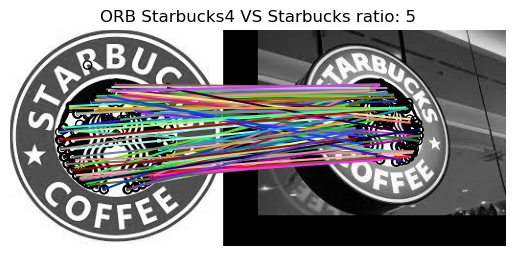

Number of matches:  84


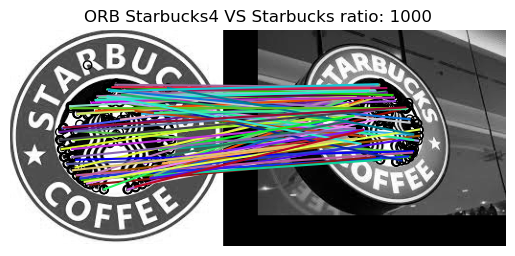

Number of matches:  84


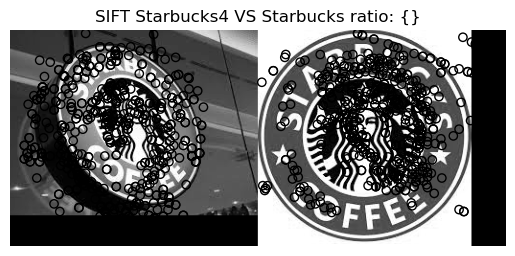

Number of matches:  0


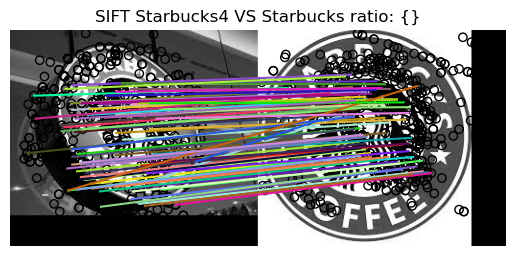

Number of matches:  82


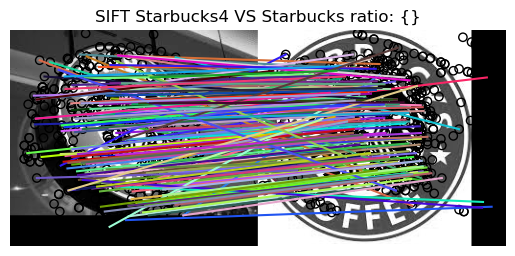

Number of matches:  177


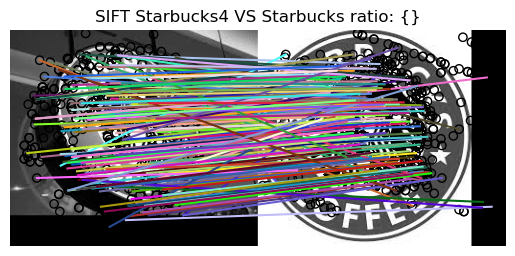

Number of matches:  177


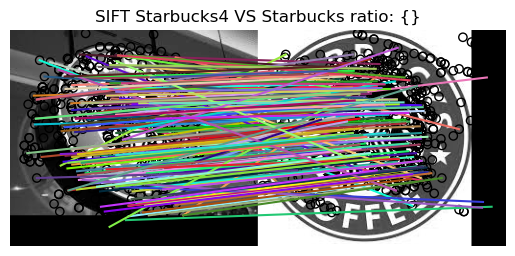

Number of matches:  177


In [279]:
from skimage.feature import SIFT


def get_SIFT(new_im, model, title, max_ratio=1.0):

    descriptor_extractor = SIFT()

    descriptor_extractor.detect_and_extract(model)
    descriptors1 = descriptor_extractor.descriptors
    keypoints1 = descriptor_extractor.keypoints

    descriptor_extractor.detect_and_extract(new_im)
    descriptors2 = descriptor_extractor.descriptors
    keypoints2 = descriptor_extractor.keypoints

    #max_ratio:Maximum ratio of distances between first and second closest descriptor in the second set of descriptors. This threshold is useful to filter
    #ambiguous matches between the two descriptor sets. The choice of this value depends on the statistics of the chosen descriptor, e.g.,
    #for SIFT descriptors a value of 0.8 is usually chosen
    matches = match_descriptors(descriptors1, descriptors2, cross_check=True, max_ratio=max_ratio)


    plot_matches(plt, new_im, model, keypoints1, keypoints2, matches)
    plt.axis('off')
    plt.title(title)
    plt.show()
    
    return len(matches)
    
starbucks = io.imread("images/starbucks.jpg", as_gray=True)

# Time comparison: starbucks4 VS starbucks
print("ORB:")
%timeit get_ORB(starbucks4, starbucks, 'starbucks VS starbucks4')
print("\nSIFT:")
%timeit get_SIFT(starbucks4, starbucks, 'starbucks VS starbucks4')

#Different ratios
ratios = [0.1, 0.8, 1, 5, 1000]
for r in ratios:
    matches = get_ORB(starbucks4, starbucks, f"ORB Starbucks4 VS Starbucks ratio: {r}", max_ratio=r)
    print("Number of matches: ", matches)

for r in ratios:
    matches = get_SIFT(starbucks4, starbucks, "SIFT Starbucks4 VS Starbucks ratio: {}", max_ratio=r)
    print("Number of matches: ", matches)
    


**4.2 (10 points)** Analyze the different SIFT parameters. Try and show the results for at least 3 different combination of parameters for starbucks4.jpg image against starbucks model image.

* What are their effect?
**Answer**: upsampling sets the upscaling factor prior to feature detection. It can be 1 (no rescaling), 2 or 4. Note that when increasing it (from 1 to 2) we get more matches. n_octaves defines the maximum number of octaves and with each one the image size is halved and the sigma parameter in the Gaussian is doubled. In our case, varying it does not seem to have any highlightable effect. n_scales is the maximum number of scales in every octave to consider (recall that SIFT achieves scale invariance by trying different scales and taking the one giving the maximum cornerness for each neighbourhood) and, because of that, the higher the value, the more coincidences we get.
* How do they compare to ORB parameters? 
**Answer**: Answer: We have found 2 groups of parameters comparable: upsampling, n_octaves (from SIFT) & downscale (from ORB) and n_scales (parameter for both functions). downscale in ORB defines a downscale factor (and upsampling in SIFT an upscale factor) but both groups of parameters are used to reduce the sensitivity to scale variance. On the other hand, both n_scales define the maximum number of scales to test: in SIFT they are referred to the octave and in ORB from the bottom of the image pyramid.
* Which algorithm is more suitable for images with rotation? And for images that have been rescaled, which one is more effective?
**Answer**: (See two codes below for experiment) In our experiment there is little change in rotation, giving the same number of matches for 45º and 90º and similar results for larger rotations. For scale, ORB gives more matches with scale = 0.5. However, for scale = 1.5 gives less coincidences than with normal scale and with SIFT we get matches proportional to the scale (the bigger it is, the more we get). Moreover, from theory we know that SIFT is scale invariant but ORB is not. We conclude SIFT is better for rescaled images.
* When it comes to changes in image intensity, which algorithm performs better, ORB or SIFT?
**Answer**:  When changing the contrast, ORB is less effective. And SIFT is capable to distinguish the corners even in different intensities

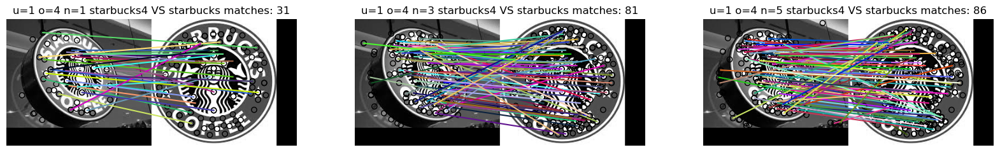

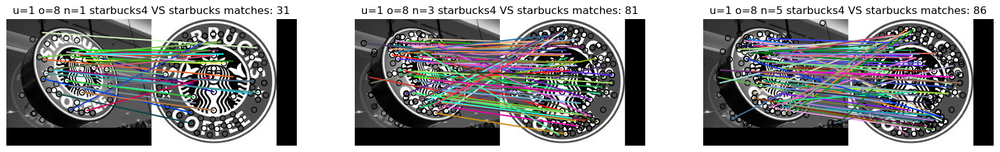

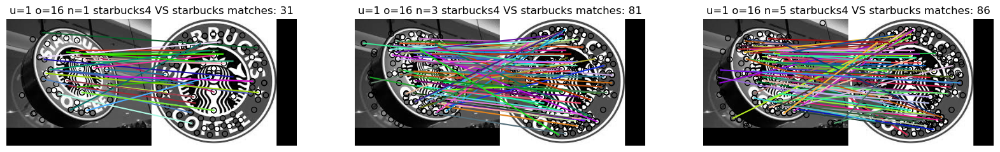

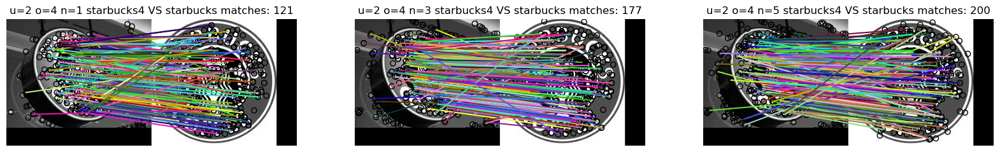

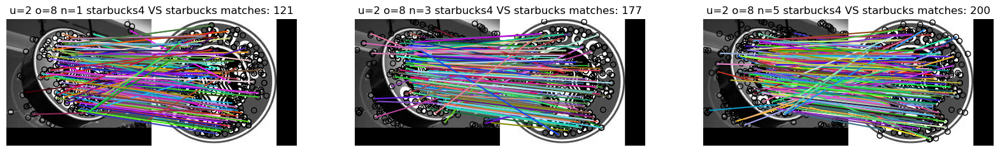

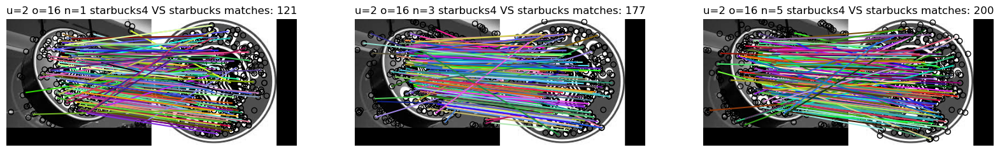

In [273]:
# Parameters to try
upsampling = [1,2]
octaves = [4,8,16]
n_scales = [1,3,5]

# Experiment (visualize in rows of 3 images) for first 2 questions
for u in upsampling:
    for o in octaves:
        fig = plt.figure(figsize=(20,30))
        for i,n in enumerate(n_scales):
            # Feature detection & extraction
            extractor = SIFT(upsampling=u, n_octaves=o, n_scales=n)

            # Features for scene
            extractor.detect_and_extract(starbucks4)
            scene_keyp = extractor.keypoints
            scene_desc = extractor.descriptors

            # Features for model
            extractor.detect_and_extract(starbucks)
            model_keyp = extractor.keypoints
            model_desc = extractor.descriptors

            # Matches
            matches = match_descriptors(scene_desc, model_desc, cross_check=True)

            # Visualization
            fig.add_subplot(3, 3, i+1)
            plot_matches(plt, starbucks4, starbucks, scene_keyp, model_keyp, matches)
            plt.title(f"u={u} o={o} n={n} starbucks4 VS starbucks matches: {len(matches)}")
            plt.axis("off")
            
        # Show images
        plt.show()

Scene rescaling & rotation (starbucks4):


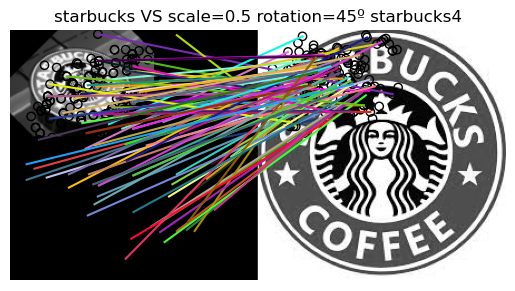

Number of matches: 93


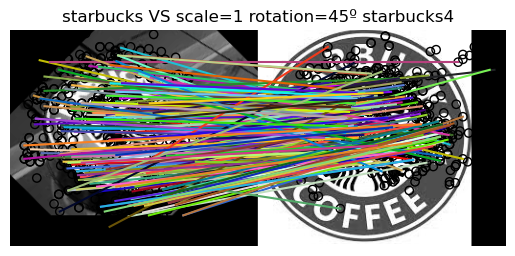

Number of matches: 194


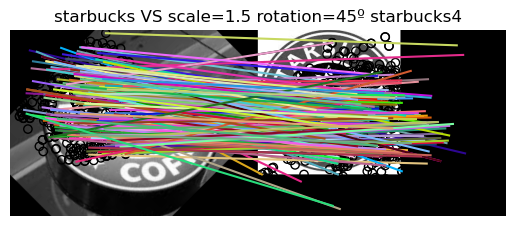

Number of matches: 203


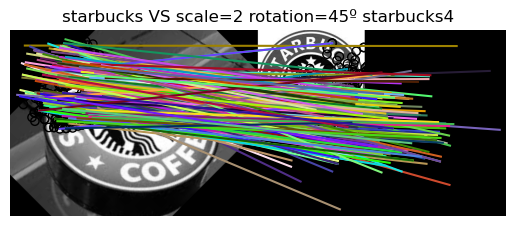

Number of matches: 217


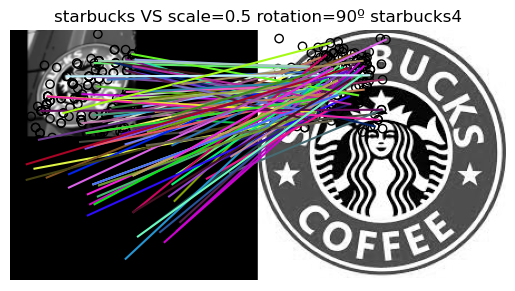

Number of matches: 94


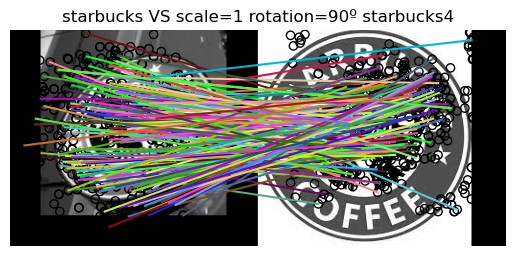

Number of matches: 182


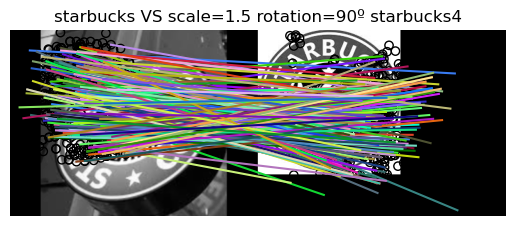

Number of matches: 205


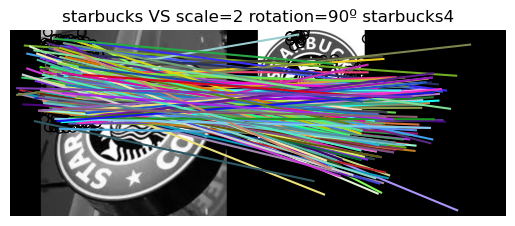

Number of matches: 208


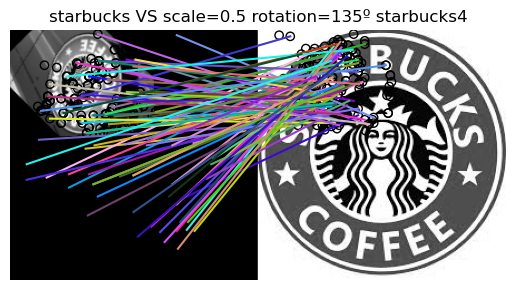

Number of matches: 88


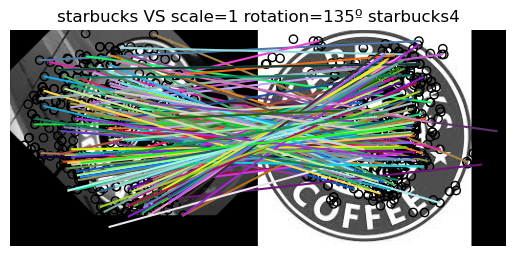

Number of matches: 183


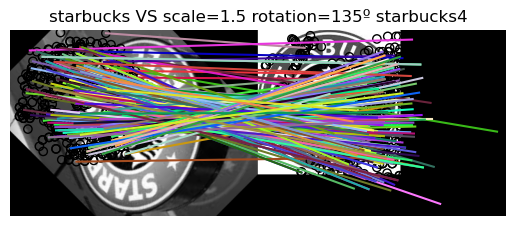

Number of matches: 193


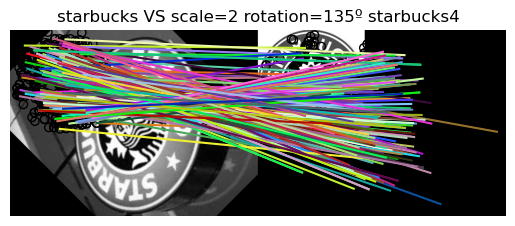

Number of matches: 210


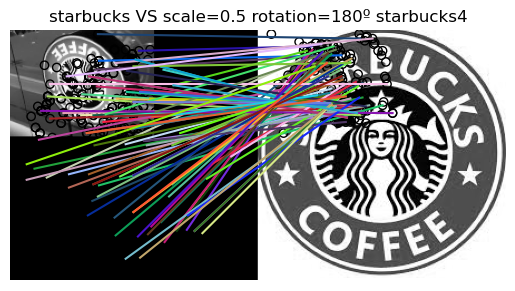

Number of matches: 91


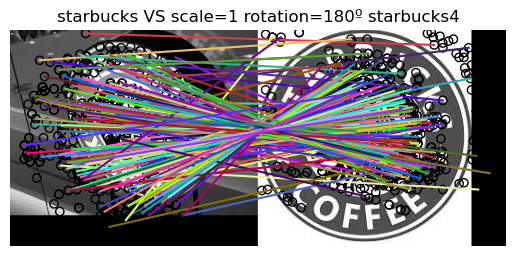

Number of matches: 177


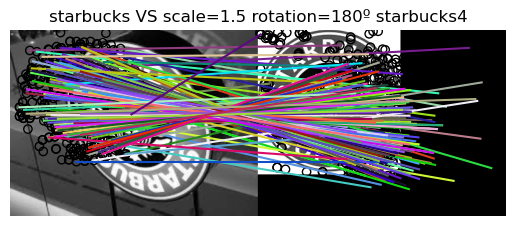

Number of matches: 210


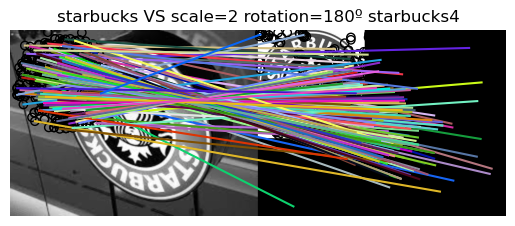

Number of matches: 215


In [280]:
"""Experiment for third question, we see how SIFT behaves with rotations and rescaling. Comparison with exercise 3.3."""

# Angles for rotation: 45º step
angles = [45, 90, 135, 180]

# Scales: 0.5 step starting at 0.5
scales = [0.5, 1, 1.5, 2]

# Scene rescaling and rotation
parameters = [[a,s] for a in angles for s in scales]
print(f"Scene rescaling & rotation (starbucks4):")
for a in angles:
    for s in scales:
        new_scene = rotate(rescale(starbucks4,s), a)
        matches = get_SIFT(new_scene, starbucks, f"starbucks VS scale={s} rotation={a}º starbucks4")
        print("Number of matches:", matches)

**4.3 (10 points)** Can we build an image classifier using the SIFT algorithm? Start by uploading the images from the folder `matches_SIFT`, then use the SIFT algorithm to find the most similar pairs (use the following parameters for this: max_ratio=0.8, upsampling=2, n_octaves=8, n_scales=3). To compare all the images, we'll need to establish a metric. We suggest to use the number of matches between images.

Show your results (SIFT result image matches and print the similarity only for the most similar image for each of the 6 images provided). Rescale the images to see the matches between images.

Answer the following: 
* Is the algorithm failing to find accurate matches (similar images) for some cases? If so, why do you think this is happening? You can assume that a good results is that eiffel tower images match between them and so on. 
**Answer:** No, the algorithm is not failing. We match *ciudad_ciencias_1* with *ciudad_ciencias_2* and vice versa. The same happens with the Eiffel Tower and Ontario images. It is difficult to fins matches and finds quite "a lot"
Here is an example of the expected results for ciudad_ciencias_1.jpg (you also have to print the similarity metric result): 

<img src="images/example_city_of_arts.png" width="400" height="300">

Best match with ciudad_ciencias_1: ciudad_ciencias_2. Number of matches: 28


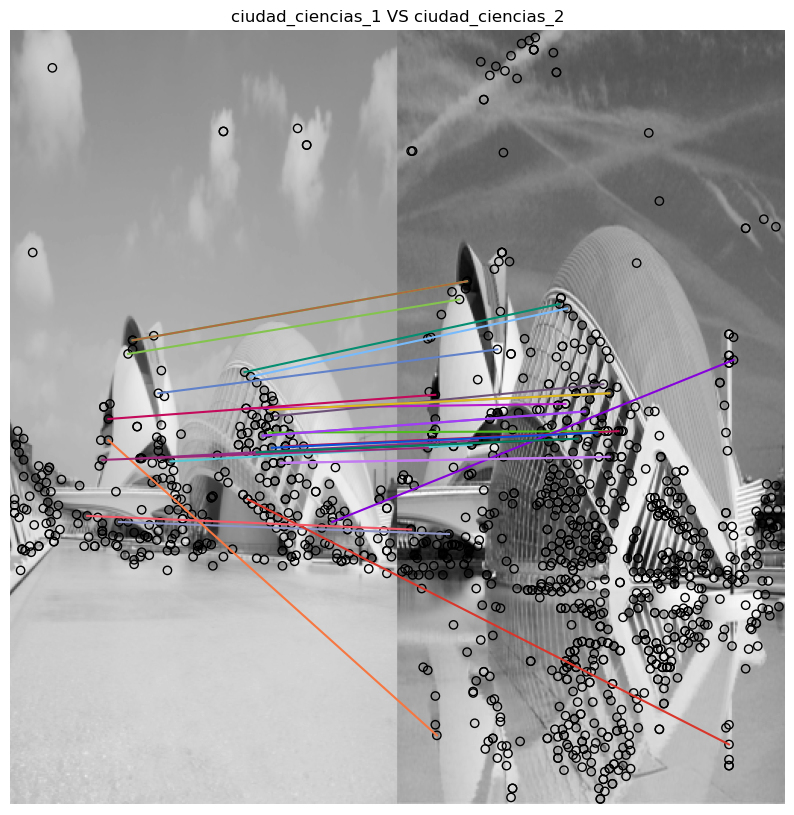

Best match with ciudad_ciencias_2: ciudad_ciencias_1. Number of matches: 32


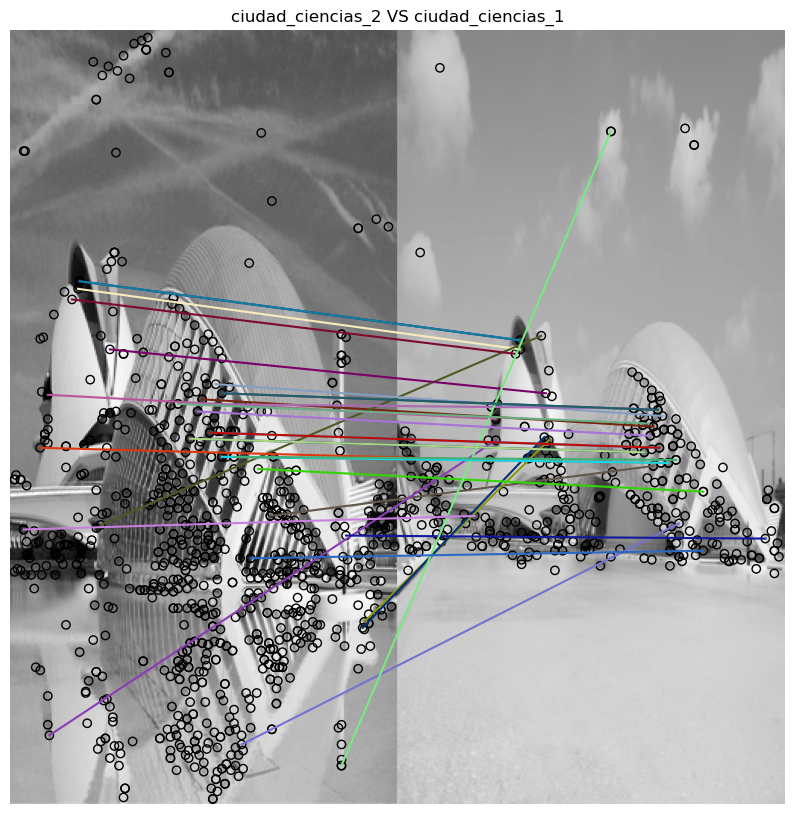

Best match with eiffel_tower_1: eiffel_tower_2. Number of matches: 32


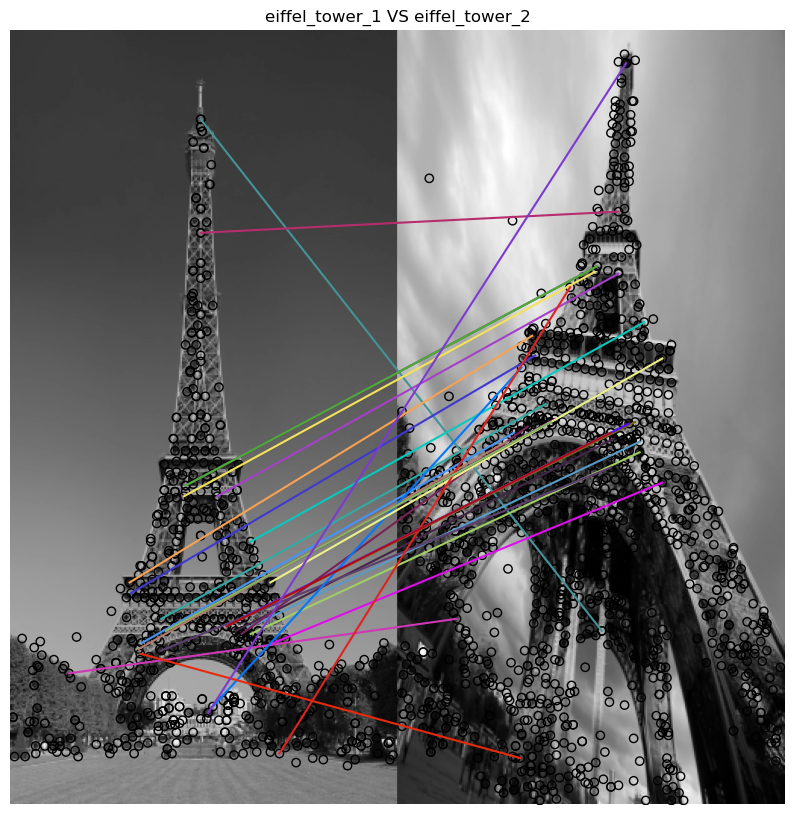

Best match with eiffel_tower_2: eiffel_tower_1. Number of matches: 34


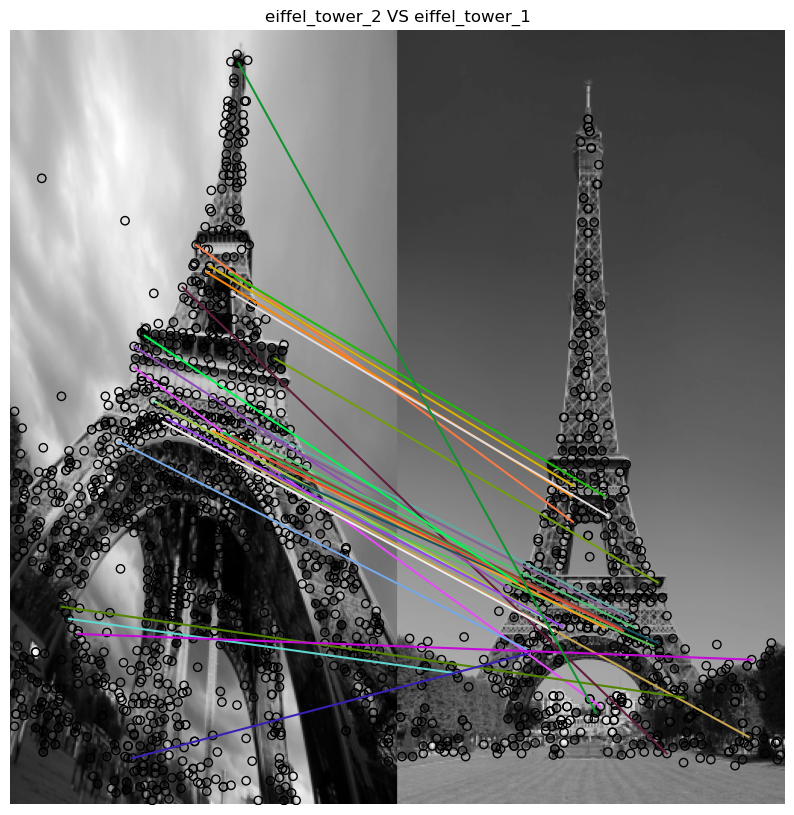

Best match with ontario1: ontario2. Number of matches: 14


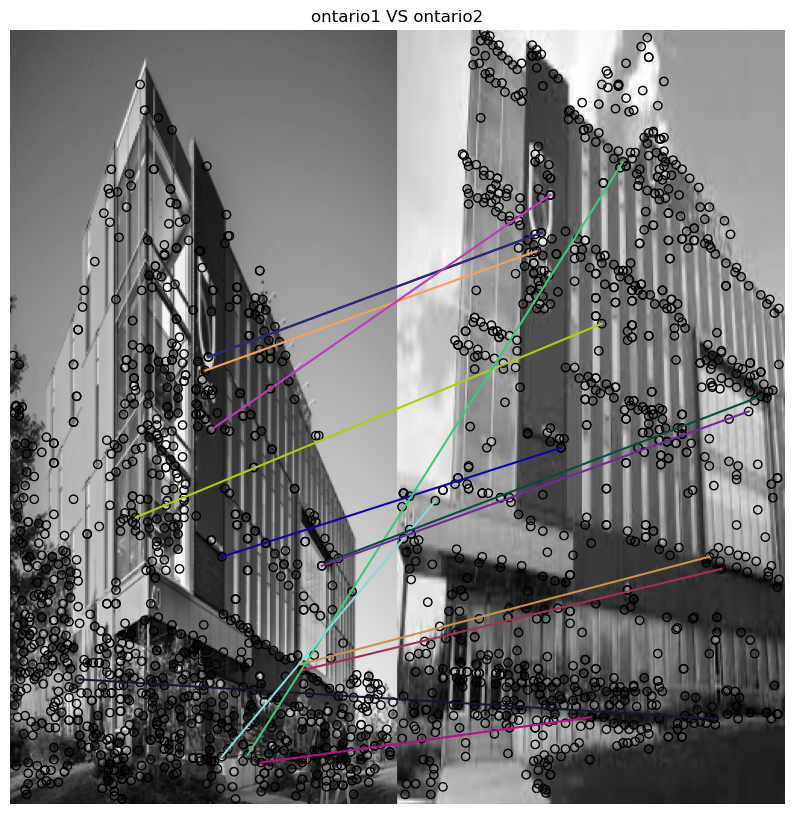

Best match with ontario2: ontario1. Number of matches: 29


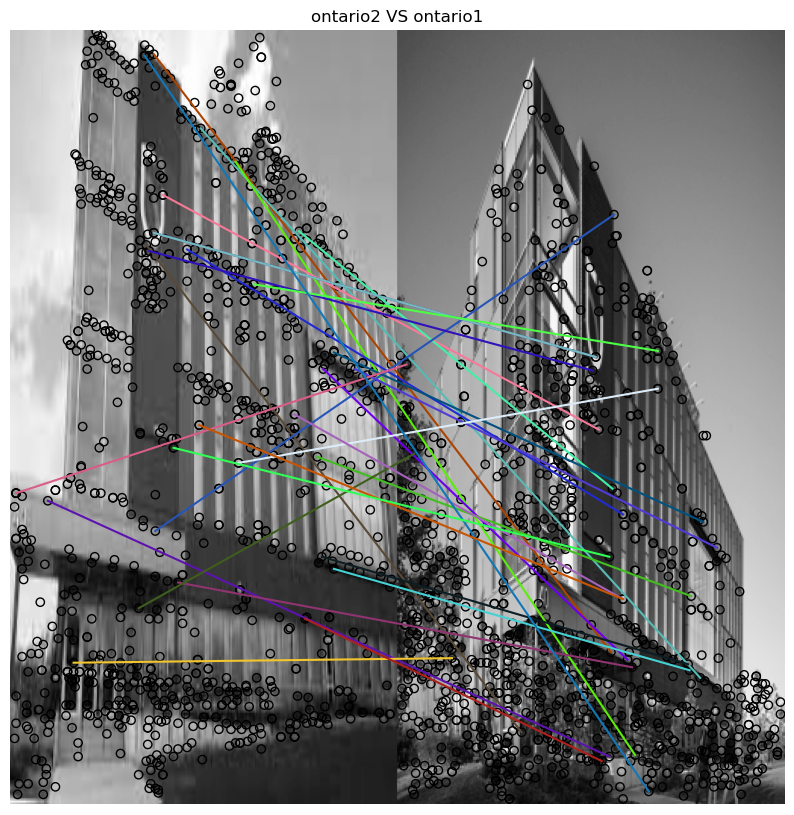

In [284]:
# Your solution here
from skimage.transform import resize # Needed for resizing

# Load images
ciencia1 = io.imread('images/matches_SIFT/ciudad_ciencias_1.jpg', as_gray=True)
ciencia2 = io.imread('images/matches_SIFT/ciudad_ciencias_2.jpg', as_gray=True)
eiffel1 = io.imread('images/matches_SIFT/eiffel_tower1.jpg', as_gray=True)
eiffel2 = io.imread('images/matches_SIFT/eiffel_tower2.jpg', as_gray=True)
ontario1 = io.imread('images/matches_SIFT/ontario1.jpg', as_gray=True)
ontario2 = io.imread('images/matches_SIFT/ontario2.jpeg', as_gray=True)

# List of images (resized to 512x256) & titles
S = (512,256)
images = [resize(ciencia1,S), resize(ciencia2,S), resize(eiffel1,S), resize(eiffel2,S), resize(ontario1,S), resize(ontario2,S)]
titles = ['ciudad_ciencias_1', 'ciudad_ciencias_2', 'eiffel_tower_1', 'eiffel_tower_2', 'ontario1', 'ontario2']

# Parameters asked, note that upsampling=2, n_octaves=8, n_scales=3 are the default parameters in SIFT
max_ratio = 0.8

# SIFT feature detector & extractor
keypoints = []
descriptors = []
extractor = SIFT()
for im in images:
    extractor.detect_and_extract(im)
    keypoints.append(extractor.keypoints)
    descriptors.append(extractor.descriptors)

# Compare images
best_matches = []
best_indexes = []
for i,(desc1,t1) in enumerate(zip(descriptors,titles)):
    best_match = None
    max_matches = -np.inf
    best_index = None
    for j,(desc2,t2) in enumerate(zip(descriptors,titles)):
        if i != j:
            # Matches
            matches = match_descriptors(desc1, desc2, cross_check=True, max_ratio=max_ratio)
            
            # Best similarity update
            if len(matches) > max_matches:
                best_match = matches
                max_matches = len(matches)
                best_index = j
                
    # Add best match data to lists
    best_matches.append(best_match)
    best_indexes.append(best_index)

# Show best similarities
for i,(m,j) in enumerate(zip(best_matches,best_indexes)):
    print(f"Best match with {titles[i]}: {titles[j]}. Number of matches: {len(m)}")
    
    # Visualize matches
    fig = plt.figure(figsize=(10,20))
    plot_matches(plt, images[i], images[j], keypoints[i], keypoints[j], m)
    plt.title(f"{titles[i]} VS {titles[j]}")
    plt.axis("off")
    plt.show()

### Appendix

In [226]:
# In case the plot_matches() function gives you some problems, you can use the following one:

from skimage.util import img_as_float
import numpy as np

def plot_matches_aux(ax, image1, image2, keypoints1, keypoints2, matches,
                 keypoints_color='k', matches_color=None, only_matches=False):
    """Plot matched features.
    Parameters
    ----------
    ax : matplotlib.axes.Axes
        Matches and image are drawn in this ax.
    image1 : (N, M [, 3]) array
        First grayscale or color image.
    image2 : (N, M [, 3]) array
        Second grayscale or color image.
    keypoints1 : (K1, 2) array
        First keypoint coordinates as ``(row, col)``.
    keypoints2 : (K2, 2) array
        Second keypoint coordinates as ``(row, col)``.
    matches : (Q, 2) array
        Indices of corresponding matches in first and second set of
        descriptors, where ``matches[:, 0]`` denote the indices in the first
        and ``matches[:, 1]`` the indices in the second set of descriptors.
    keypoints_color : matplotlib color, optional
        Color for keypoint locations.
    matches_color : matplotlib color, optional
        Color for lines which connect keypoint matches. By default the
        color is chosen randomly.
    only_matches : bool, optional
        Whether to only plot matches and not plot the keypoint locations.
    """

    image1 = img_as_float(image1)
    image2 = img_as_float(image2)

    new_shape1 = list(image1.shape)
    new_shape2 = list(image2.shape)

    if image1.shape[0] < image2.shape[0]:
        new_shape1[0] = image2.shape[0]
    elif image1.shape[0] > image2.shape[0]:
        new_shape2[0] = image1.shape[0]

    if image1.shape[1] < image2.shape[1]:
        new_shape1[1] = image2.shape[1]
    elif image1.shape[1] > image2.shape[1]:
        new_shape2[1] = image1.shape[1]

    if new_shape1 != image1.shape:
        new_image1 = np.zeros(new_shape1, dtype=image1.dtype)
        new_image1[:image1.shape[0], :image1.shape[1]] = image1
        image1 = new_image1

    if new_shape2 != image2.shape:
        new_image2 = np.zeros(new_shape2, dtype=image2.dtype)
        new_image2[:image2.shape[0], :image2.shape[1]] = image2
        image2 = new_image2

    image = np.concatenate([image1, image2], axis=1)

    offset = image1.shape

    if not only_matches:
        ax.scatter(keypoints1[:, 1], keypoints1[:, 0],
                   facecolors='none', edgecolors=keypoints_color)
        ax.scatter(keypoints2[:, 1] + offset[1], keypoints2[:, 0],
                   facecolors='none', edgecolors=keypoints_color)

    ax.imshow(image, interpolation='nearest', cmap='gray')
    ax.axis((0, 2 * offset[1], offset[0], 0))

    for i in range(matches.shape[0]):
        idx1 = matches[i, 0]
        idx2 = matches[i, 1]

        if matches_color is None:
            color = np.random.rand(3)
        else:
            color = matches_color

        ax.plot((keypoints1[idx1, 1], keypoints2[idx2, 1] + offset[1]),
                (keypoints1[idx1, 0], keypoints2[idx2, 0]),
                '-', color=color)